In [24]:
import random
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import math

import sklearn
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score
from sklearn.linear_model import LinearRegression
from sklearn import preprocessing
from sklearn.preprocessing import StandardScaler

In [25]:
df = pd.read_csv('../data/weather_data.csv')

df['relative_humidity'] = df['relative_humidity'].apply(lambda x: min(x, 1))

df_time = df.copy()
df_time['date_time'] = pd.date_range(start='1/1/2010 11:00:00', periods=100057, freq='h', tz='Australia/Sydney')

temp_2 = (df['mean_sea_level_pressure'] < 98000).astype(int).values
df['low_p_dummy'] = temp_2
df_time['low_p_dummy'] = temp_2

temp_3 = (df['surface_solar_radiation'] > 0).astype(int)
df['day_night_dummy'] = temp_3
df_time['day_night_dummy'] = temp_3

df_final = df_time.copy()
scaler = StandardScaler()
df_final['temperature'] = scaler.fit_transform(df_time[['temperature']])
df_final['wind_speed'] = scaler.fit_transform(df_time[['wind_speed']])
df_final['mean_sea_level_pressure'] = scaler.fit_transform(df_time[['mean_sea_level_pressure']])
df_final['surface_solar_radiation'] = df_time[['surface_solar_radiation']] / 1000
df_final['surface_thermal_radiation'] = scaler.fit_transform(df_time[['surface_thermal_radiation']])

# LSTM

In [26]:
from tensorflow import keras
import tensorflow as tf

## Train-test split

In [27]:
cutoff = int(len(df_final) * 0.8,)
df_train = df_final.iloc[:cutoff,]
df_test = df_final.iloc[cutoff:,]

## LSTM modelling functions

### Data preparation

In [28]:
def train_test_data(data, lag, prediction_lag, sampling_rate):

    training_size = int(0.8 * data.shape[0])  
    train_data = data.loc[0 : training_size - 1]
    val_data = data.loc[training_size:]
    sequence_length = int(lag / sampling_rate)

    # training dataset
    start = lag + prediction_lag
    end = start + training_size

    x_train = train_data.drop(columns=['date_time', 'relative_humidity']).values
    y_train = data.iloc[start:end][['relative_humidity']].values
    
    # validation dataset
    val_start = training_size + start
    val_end = len(val_data)

    val_start = training_size + start
    val_end = len(val_data) - start

    x_val = val_data.drop(columns=['date_time', 'relative_humidity']).iloc[:val_end].values
    y_val = data.iloc[val_start:][['relative_humidity']].values

    return x_train, y_train, x_val, y_val, sequence_length


In [29]:
def get_datasets(data, lag, prediction_lag, sampling_rate, batch_size):

    x_train, y_train, x_val, y_val, sequence_length = train_test_data(data, lag, prediction_lag, sampling_rate)

    # train dataset

    dataset_train = keras.preprocessing.timeseries_dataset_from_array(
        data = x_train,
        targets = y_train,
        sequence_length = sequence_length,
        sampling_rate = sampling_rate,
        batch_size = batch_size,
    )

    # validation dataset

    dataset_val = keras.preprocessing.timeseries_dataset_from_array(
        data = x_val,
        targets = y_val,
        sequence_length = sequence_length,
        sampling_rate = sampling_rate,
        batch_size = batch_size,
    )

    return dataset_train, dataset_val, sequence_length

### Model construction

In [30]:
def train_LSTM_model(data, lag, prediction_lag, sampling_rate, batch_size, neurons_per_layer, hidden_layers, loss):
    
    dataset_train, dataset_val, sequence_length = get_datasets(data, lag, prediction_lag, sampling_rate, batch_size)

    for batch in dataset_train.take(1):
        inputs, targets = batch
    
    inputs = keras.layers.Input(shape=(inputs.shape[1], inputs.shape[2]))
    for _ in range(hidden_layers):
        lstm_out = keras.layers.LSTM(neurons_per_layer)(inputs)
    outputs = keras.layers.Dense(1, activation='linear')(lstm_out)

    model = keras.Model(name="Weather_forcaster",inputs=inputs, outputs=outputs)
    model.compile(optimizer=keras.optimizers.Adam(learning_rate=0.001), loss=loss)
    model.summary()

    return dataset_train, dataset_val, model

In [31]:
def fit_lstm(data, prediction_lag, lag, sampling_rate, batch_size, neurons_per_layer, epochs, hidden_layers, loss):
    x_train, y_train, x_val, y_val, sequence_length = train_test_data(data, lag, prediction_lag, sampling_rate)
    dataset_train, dataset_val, model = train_LSTM_model(data, lag, prediction_lag, sampling_rate, batch_size, neurons_per_layer, hidden_layers, loss)

    history = model.fit(
        dataset_train,
        epochs = epochs,
        validation_data = dataset_val
    )

    loss = history.history["loss"]
    val_loss = history.history["val_loss"]
    data_split = x_train, y_train, x_val, y_val, sequence_length

    return dataset_train, dataset_val, model, loss, val_loss, data_split


### Plotting and evaluation

In [32]:
from sklearn.metrics import r2_score, mean_absolute_error, mean_squared_error

In [33]:
def plot_lstm_results(trained_model):
    dataset_train, dataset_val, model, loss, val_loss, data_split = trained_model
    x_train, y_train, x_val, y_val, sequence_length = data_split
    fig, axs = plt.subplots(3, 1, figsize=(15, 15))

    epochs = range(len(loss))
    fitted_train = model.predict(dataset_train)
    y_train_pred = model.predict(dataset_train).flatten()
    y_train_true = np.concatenate([y for x, y in dataset_train])
    r2_train = r2_score(y_train_true, y_train_pred)
    fitted_val = model.predict(dataset_val)
    y_val_pred = model.predict(dataset_val).flatten()
    y_val_true = np.concatenate([y for x, y in dataset_val])
    r2_val = r2_score(y_val_true, y_val_pred)

    # Plot training and validation loss
    axs[0].plot(epochs, loss, label="Training loss", color="blue")
    axs[0].plot(epochs, val_loss, label="Validation loss", color="orange")
    axs[0].set_title("Loss")
    axs[0].set_xlabel("Epochs")
    axs[0].set_ylabel("Loss")
    axs[0].legend()

    # Plot training fit
    axs[1].scatter(range(len(y_train)), y_train, label="Actual", color="orange", alpha=0.5, s=1)
    axs[1].scatter(range(len(fitted_train)), fitted_train, label="Fitted", color="blue", alpha=0.5, s=1)
    axs[1].set_title(f"Training fit | R² = {r2_train:.4f}")
    axs[1].set_xlabel("Time")
    axs[1].set_ylabel("y")
    axs[1].legend()
    
    # Plot validation fit
    axs[2].scatter(range(len(y_val)), y_val, label="Actual", color="orange", alpha=0.5, s=1)
    axs[2].scatter(range(len(fitted_val)), fitted_val, label="Fitted", color="blue", alpha=0.5, s=1)
    axs[2].set_title(f"Validation fit | R² = {r2_val:.4f}")
    axs[2].set_xlabel("Time")
    axs[2].set_ylabel("y")
    axs[2].legend()

    plt.tight_layout()
    plt.show()

### Trial

2025-04-05 11:02:31.027370: I tensorflow/core/framework/local_rendezvous.cc:407] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence


Model: "Weather_forcaster"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)        │ (None, 36, 8)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_2 (LSTM)                   │ (None, 24)             │         3,168 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense (Dense)                   │ (None, 1)              │            25 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 3,193 (12.47 KB)

 Trainable params: 3,193 (12.47 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/15
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 8s 8ms/step - loss: 0.1535 - val_loss: 0.0857
Epoch 2/15
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 8s 8ms/step - loss: 0.0661 - val_loss: 0.0811
Epoch 3/15
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 7s 7ms/step - loss: 0.0631 - val_loss: 0.0797
Epoch 4/15
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 7s 7ms/step - loss: 0.0617 - val_loss: 0.0792
Epoch 5/15
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 7s 7ms/step - loss: 0.0603 - val_loss: 0.0807
Epoch 6/15
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 7s 7ms/step - loss: 0.0594 - val_loss: 0.0815
Epoch 7/15
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 7s 7ms/step - loss: 0.0585 - val_loss: 0.0827
Epoch 8/15
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 7s 7ms/step - loss: 0.0576 - val_loss: 0.0823
Epoch 9/15
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 7s 7ms/step - loss: 0.0569 - val_loss: 0.0815
Epoch 10/15
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 7s 7ms/step - loss: 0.0563 - val_loss: 0.0805
Epoch 11/15
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 7s 7ms/step - loss: 0.0559 - val_loss: 0.0799
Epoch 12/15
1000/1000 ━━━━━━━━

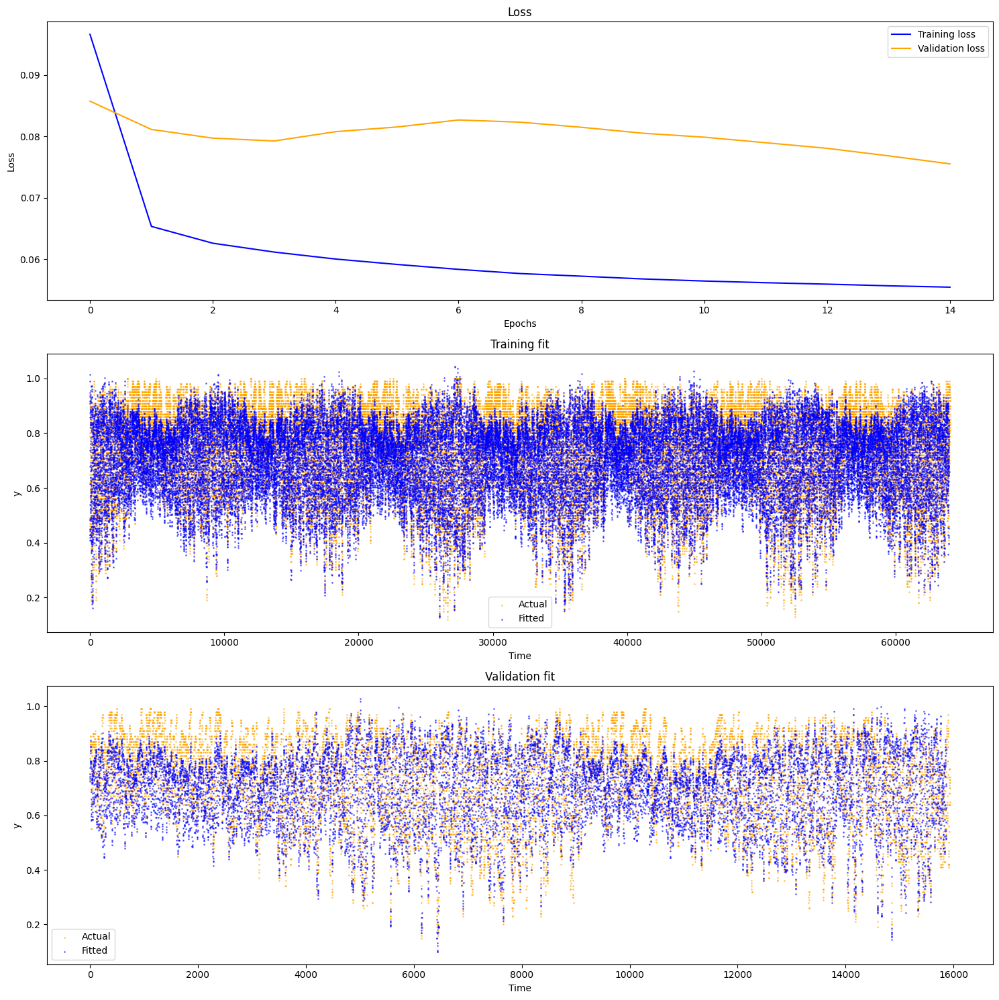

In [14]:
trained_model = fit_lstm(df_train, 1, 72, 2, 64, 24, 15, 3, "mae")
plot_lstm_results(trained_model)

## Manual hyperparameter tuning

In [ ]:
param_grid = {"lag": [6, 24, 48, 72], 
              "sampling_rate": [1, 2, 4], 
              "batch_size": [32, 64, 128], 
              "neurons_per_layer": [32, 64],
              "hidden_layers": [2, 3, 4]}

In [23]:
set_of_params_to_try = []
while len(set_of_params_to_try) < 20:
    new_set = {}
    for param in param_grid:
        new_set[param] = random.choice(param_grid[param])
    if new_set not in set_of_params_to_try:
        set_of_params_to_try.append(new_set)

Out of the options for the values of each parameter in `param_grid`, the code chunk above randomly produces 20 combinations of parameter values to try.

In [29]:
set_of_params_to_try

[{'lag': 48,
  'sampling_rate': 1,
  'batch_size': 64,
  'neurons_per_layer': 32,
  'hidden_layers': 2},
 {'lag': 48,
  'sampling_rate': 4,
  'batch_size': 128,
  'neurons_per_layer': 64,
  'hidden_layers': 3},
 {'lag': 48,
  'sampling_rate': 2,
  'batch_size': 32,
  'neurons_per_layer': 64,
  'hidden_layers': 4},
 {'lag': 72,
  'sampling_rate': 1,
  'batch_size': 32,
  'neurons_per_layer': 32,
  'hidden_layers': 4},
 {'lag': 24,
  'sampling_rate': 4,
  'batch_size': 64,
  'neurons_per_layer': 32,
  'hidden_layers': 2},
 {'lag': 6,
  'sampling_rate': 2,
  'batch_size': 32,
  'neurons_per_layer': 32,
  'hidden_layers': 4},
 {'lag': 24,
  'sampling_rate': 1,
  'batch_size': 64,
  'neurons_per_layer': 32,
  'hidden_layers': 4},
 {'lag': 48,
  'sampling_rate': 1,
  'batch_size': 128,
  'neurons_per_layer': 32,
  'hidden_layers': 2},
 {'lag': 6,
  'sampling_rate': 4,
  'batch_size': 64,
  'neurons_per_layer': 32,
  'hidden_layers': 3},
 {'lag': 24,
  'sampling_rate': 4,
  'batch_size': 64,


In [24]:
lags, sampling_rates, batch_sizes, neurons_per_layers, n_hidden_layers = param_grid.values()
best_model_mae = None
lowest_mae = None
best_model_mse = None
lowest_mse = None
best_params_mae = {"lag": None, 
              "sampling_rate": None, 
              "batch_size": None, 
              "neurons_per_layer": None,
              "hidden_layers": None}
best_params_mse = {"lag": None, 
              "sampling_rate": None, 
              "batch_size": None, 
              "neurons_per_layer": None,
              "hidden_layers": None}

for set in set_of_params_to_try:
    print(f"Set: {set}")

    lag = set["lag"]
    sampling_rate = set["sampling_rate"]
    batch_size = set["batch_size"]
    neurons_per_layer = set["neurons_per_layer"]
    hidden_layers = set["hidden_layers"]

    new_model_mae = fit_lstm(df_train, 1, lag, sampling_rate, batch_size, neurons_per_layer, 30, hidden_layers, "mae")
    min_mae = min(new_model_mae[4])
    if best_model_mae == None:
        best_model_mae = new_model_mae
        lowest_mae = min_mae
        best_params_mae = {"lag": lag, 
            "sampling_rate": sampling_rate, 
            "batch_size": batch_size, 
            "neurons_per_layer": neurons_per_layer,
            "hidden_layers": hidden_layers}
        print(f'Update lowest MAE: {lowest_mae}')
        print(best_params_mae)
    elif min_mae < lowest_mae:
        best_model_mae = new_model_mae
        lowest_mae = min_mae
        best_params_mae = {"lag": lag, 
            "sampling_rate": sampling_rate, 
            "batch_size": batch_size, 
            "neurons_per_layer": neurons_per_layer,
            "hidden_layers": hidden_layers}
        print(f'Update lowest MAE: {lowest_mae}')
        print(best_params_mae)
    
    new_model_mse = fit_lstm(df_train, 1, lag, sampling_rate, batch_size, neurons_per_layer, 30, hidden_layers, "mse")
    min_mse = min(new_model_mse[4])
    if best_model_mse == None:
        best_model_mse = new_model_mse
        lowest_mse = min_mse
        best_params_mse = {"lag": lag, 
            "sampling_rate": sampling_rate, 
            "batch_size": batch_size, 
            "neurons_per_layer": neurons_per_layer,
            "hidden_layers": hidden_layers}
        print(f'Update lowest MSE: {lowest_mse}')
        print(best_params_mse)
    elif min_mse < lowest_mse:
        best_model_mse = new_model_mse
        lowest_mse = min_mse
        best_params_mse = {"lag": lag, 
            "sampling_rate": sampling_rate, 
            "batch_size": batch_size, 
            "neurons_per_layer": neurons_per_layer,
            "hidden_layers": hidden_layers}
        print(f'Update lowest MSE: {lowest_mse}')

Set: {'lag': 48, 'sampling_rate': 1, 'batch_size': 64, 'neurons_per_layer': 32, 'hidden_layers': 2}


Model: "Weather_forcaster"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer_2 (InputLayer)      │ (None, 48, 8)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_6 (LSTM)                   │ (None, 32)             │         5,248 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_2 (Dense)                 │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 5,281 (20.63 KB)

 Trainable params: 5,281 (20.63 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/30
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 11s 10ms/step - loss: 0.1375 - val_loss: 0.0704
Epoch 2/30
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 9s 9ms/step - loss: 0.0615 - val_loss: 0.0652
Epoch 3/30
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 9s 9ms/step - loss: 0.0584 - val_loss: 0.0651
Epoch 4/30
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 10s 10ms/step - loss: 0.0566 - val_loss: 0.0657
Epoch 5/30
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 9s 9ms/step - loss: 0.0557 - val_loss: 0.0660
Epoch 6/30
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 9s 9ms/step - loss: 0.0549 - val_loss: 0.0656
Epoch 7/30
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 9s 9ms/step - loss: 0.0542 - val_loss: 0.0665
Epoch 8/30
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 9s 9ms/step - loss: 0.0537 - val_loss: 0.0669
Epoch 9/30
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 9s 9ms/step - loss: 0.0532 - val_loss: 0.0667
Epoch 10/30
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 10s 10ms/step - loss: 0.0527 - val_loss: 0.0675
Epoch 11/30
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 10s 10ms/step - loss: 0.0520 - val_loss: 0.0676
Epoch 12/30
1000/1000 

2025-04-05 11:20:39.197256: I tensorflow/core/framework/local_rendezvous.cc:407] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence


Model: "Weather_forcaster"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer_3 (InputLayer)      │ (None, 48, 8)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_8 (LSTM)                   │ (None, 32)             │         5,248 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_3 (Dense)                 │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 5,281 (20.63 KB)

 Trainable params: 5,281 (20.63 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/30
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 10s 10ms/step - loss: 0.0350 - val_loss: 0.0077
Epoch 2/30
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 9s 9ms/step - loss: 0.0062 - val_loss: 0.0070
Epoch 3/30
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 9s 9ms/step - loss: 0.0056 - val_loss: 0.0069
Epoch 4/30
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 9s 8ms/step - loss: 0.0053 - val_loss: 0.0069
Epoch 5/30
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 10s 10ms/step - loss: 0.0051 - val_loss: 0.0069
Epoch 6/30
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 11s 11ms/step - loss: 0.0050 - val_loss: 0.0069
Epoch 7/30
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 10s 10ms/step - loss: 0.0048 - val_loss: 0.0068
Epoch 8/30
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 9s 9ms/step - loss: 0.0047 - val_loss: 0.0068
Epoch 9/30
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 9s 9ms/step - loss: 0.0046 - val_loss: 0.0067
Epoch 10/30
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 9s 9ms/step - loss: 0.0046 - val_loss: 0.0067
Epoch 11/30
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 9s 9ms/step - loss: 0.0045 - val_loss: 0.0067
Epoch 12/30
1000/1000 

Model: "Weather_forcaster"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer_4 (InputLayer)      │ (None, 12, 8)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_11 (LSTM)                  │ (None, 64)             │        18,688 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_4 (Dense)                 │ (None, 1)              │            65 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 18,753 (73.25 KB)

 Trainable params: 18,753 (73.25 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/30
500/500 ━━━━━━━━━━━━━━━━━━━━ 7s 13ms/step - loss: 0.1714 - val_loss: 0.1625
Epoch 2/30
500/500 ━━━━━━━━━━━━━━━━━━━━ 7s 15ms/step - loss: 0.1028 - val_loss: 0.1334
Epoch 3/30
500/500 ━━━━━━━━━━━━━━━━━━━━ 8s 17ms/step - loss: 0.0916 - val_loss: 0.1122
Epoch 4/30
500/500 ━━━━━━━━━━━━━━━━━━━━ 7s 14ms/step - loss: 0.0826 - val_loss: 0.1012
Epoch 5/30
500/500 ━━━━━━━━━━━━━━━━━━━━ 7s 14ms/step - loss: 0.0775 - val_loss: 0.0936
Epoch 6/30
500/500 ━━━━━━━━━━━━━━━━━━━━ 7s 13ms/step - loss: 0.0734 - val_loss: 0.0880
Epoch 7/30
500/500 ━━━━━━━━━━━━━━━━━━━━ 7s 13ms/step - loss: 0.0700 - val_loss: 0.0854
Epoch 8/30
500/500 ━━━━━━━━━━━━━━━━━━━━ 7s 13ms/step - loss: 0.0680 - val_loss: 0.0816
Epoch 9/30
500/500 ━━━━━━━━━━━━━━━━━━━━ 7s 15ms/step - loss: 0.0662 - val_loss: 0.0779
Epoch 10/30
500/500 ━━━━━━━━━━━━━━━━━━━━ 7s 14ms/step - loss: 0.0645 - val_loss: 0.0749
Epoch 11/30
500/500 ━━━━━━━━━━━━━━━━━━━━ 7s 13ms/step - loss: 0.0631 - val_loss: 0.0728
Epoch 12/30
500/500 ━━━━━━━━━━━━━━━━━━━━ 

Model: "Weather_forcaster"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer_5 (InputLayer)      │ (None, 12, 8)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_14 (LSTM)                  │ (None, 64)             │        18,688 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_5 (Dense)                 │ (None, 1)              │            65 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 18,753 (73.25 KB)

 Trainable params: 18,753 (73.25 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/30
500/500 ━━━━━━━━━━━━━━━━━━━━ 8s 14ms/step - loss: 0.0737 - val_loss: 0.0459
Epoch 2/30
500/500 ━━━━━━━━━━━━━━━━━━━━ 7s 13ms/step - loss: 0.0194 - val_loss: 0.0255
Epoch 3/30
500/500 ━━━━━━━━━━━━━━━━━━━━ 7s 13ms/step - loss: 0.0142 - val_loss: 0.0179
Epoch 4/30
500/500 ━━━━━━━━━━━━━━━━━━━━ 7s 15ms/step - loss: 0.0115 - val_loss: 0.0157
Epoch 5/30
500/500 ━━━━━━━━━━━━━━━━━━━━ 7s 14ms/step - loss: 0.0103 - val_loss: 0.0147
Epoch 6/30
500/500 ━━━━━━━━━━━━━━━━━━━━ 7s 14ms/step - loss: 0.0096 - val_loss: 0.0139
Epoch 7/30
500/500 ━━━━━━━━━━━━━━━━━━━━ 8s 16ms/step - loss: 0.0091 - val_loss: 0.0132
Epoch 8/30
500/500 ━━━━━━━━━━━━━━━━━━━━ 8s 16ms/step - loss: 0.0086 - val_loss: 0.0126
Epoch 9/30
500/500 ━━━━━━━━━━━━━━━━━━━━ 7s 14ms/step - loss: 0.0082 - val_loss: 0.0121
Epoch 10/30
500/500 ━━━━━━━━━━━━━━━━━━━━ 7s 14ms/step - loss: 0.0079 - val_loss: 0.0116
Epoch 11/30
500/500 ━━━━━━━━━━━━━━━━━━━━ 7s 14ms/step - loss: 0.0075 - val_loss: 0.0112
Epoch 12/30
500/500 ━━━━━━━━━━━━━━━━━━━━ 

Model: "Weather_forcaster"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer_6 (InputLayer)      │ (None, 24, 8)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_18 (LSTM)                  │ (None, 64)             │        18,688 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_6 (Dense)                 │ (None, 1)              │            65 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 18,753 (73.25 KB)

 Trainable params: 18,753 (73.25 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/30
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 13s 6ms/step - loss: 0.1041 - val_loss: 0.0909
Epoch 2/30
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 11s 6ms/step - loss: 0.0653 - val_loss: 0.0790
Epoch 3/30
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 11s 6ms/step - loss: 0.0616 - val_loss: 0.0739
Epoch 4/30
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 11s 6ms/step - loss: 0.0593 - val_loss: 0.0725
Epoch 5/30
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 12s 6ms/step - loss: 0.0571 - val_loss: 0.0719
Epoch 6/30
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 12s 6ms/step - loss: 0.0561 - val_loss: 0.0725
Epoch 7/30
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 12s 6ms/step - loss: 0.0551 - val_loss: 0.0725
Epoch 8/30
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 13s 6ms/step - loss: 0.0545 - val_loss: 0.0727
Epoch 9/30
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 13s 7ms/step - loss: 0.0537 - val_loss: 0.0728
Epoch 10/30
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 13s 6ms/step - loss: 0.0532 - val_loss: 0.0726
Epoch 11/30
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 12s 6ms/step - loss: 0.0527 - val_loss: 0.0723
Epoch 12/30
2000/20

2025-04-05 11:38:29.004928: I tensorflow/core/framework/local_rendezvous.cc:407] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence


Model: "Weather_forcaster"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer_7 (InputLayer)      │ (None, 24, 8)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_22 (LSTM)                  │ (None, 64)             │        18,688 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_7 (Dense)                 │ (None, 1)              │            65 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 18,753 (73.25 KB)

 Trainable params: 18,753 (73.25 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/30
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 12s 6ms/step - loss: 0.0230 - val_loss: 0.0125
Epoch 2/30
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 17s 8ms/step - loss: 0.0070 - val_loss: 0.0101
Epoch 3/30
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 11s 6ms/step - loss: 0.0063 - val_loss: 0.0092
Epoch 4/30
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 11s 6ms/step - loss: 0.0059 - val_loss: 0.0089
Epoch 5/30
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 11s 5ms/step - loss: 0.0056 - val_loss: 0.0087
Epoch 6/30
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 10s 5ms/step - loss: 0.0054 - val_loss: 0.0088
Epoch 7/30
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 11s 5ms/step - loss: 0.0052 - val_loss: 0.0090
Epoch 8/30
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 11s 5ms/step - loss: 0.0051 - val_loss: 0.0091
Epoch 9/30
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 11s 6ms/step - loss: 0.0050 - val_loss: 0.0092
Epoch 10/30
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 12s 6ms/step - loss: 0.0049 - val_loss: 0.0092
Epoch 11/30
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 10s 5ms/step - loss: 0.0048 - val_loss: 0.0092
Epoch 12/30
2000/20

Model: "Weather_forcaster"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer_8 (InputLayer)      │ (None, 72, 8)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_26 (LSTM)                  │ (None, 32)             │         5,248 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_8 (Dense)                 │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 5,281 (20.63 KB)

 Trainable params: 5,281 (20.63 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/30
1999/1999 ━━━━━━━━━━━━━━━━━━━━ 21s 10ms/step - loss: 0.0970 - val_loss: 0.0710
Epoch 2/30
1999/1999 ━━━━━━━━━━━━━━━━━━━━ 20s 10ms/step - loss: 0.0616 - val_loss: 0.0640
Epoch 3/30
1999/1999 ━━━━━━━━━━━━━━━━━━━━ 21s 11ms/step - loss: 0.0572 - val_loss: 0.0627
Epoch 4/30
1999/1999 ━━━━━━━━━━━━━━━━━━━━ 17s 8ms/step - loss: 0.0551 - val_loss: 0.0629
Epoch 5/30
1999/1999 ━━━━━━━━━━━━━━━━━━━━ 17s 8ms/step - loss: 0.0536 - val_loss: 0.0633
Epoch 6/30
1999/1999 ━━━━━━━━━━━━━━━━━━━━ 17s 9ms/step - loss: 0.0527 - val_loss: 0.0632
Epoch 7/30
1999/1999 ━━━━━━━━━━━━━━━━━━━━ 17s 9ms/step - loss: 0.0521 - val_loss: 0.0632
Epoch 8/30
1999/1999 ━━━━━━━━━━━━━━━━━━━━ 18s 9ms/step - loss: 0.0515 - val_loss: 0.0630
Epoch 9/30
1999/1999 ━━━━━━━━━━━━━━━━━━━━ 20s 10ms/step - loss: 0.0509 - val_loss: 0.0629
Epoch 10/30
1999/1999 ━━━━━━━━━━━━━━━━━━━━ 19s 9ms/step - loss: 0.0506 - val_loss: 0.0629
Epoch 11/30
1999/1999 ━━━━━━━━━━━━━━━━━━━━ 19s 9ms/step - loss: 0.0501 - val_loss: 0.0627
Epoch 12/30
199

Model: "Weather_forcaster"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer_9 (InputLayer)      │ (None, 72, 8)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_30 (LSTM)                  │ (None, 32)             │         5,248 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_9 (Dense)                 │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 5,281 (20.63 KB)

 Trainable params: 5,281 (20.63 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/30
1999/1999 ━━━━━━━━━━━━━━━━━━━━ 20s 10ms/step - loss: 0.0392 - val_loss: 0.0079
Epoch 2/30
1999/1999 ━━━━━━━━━━━━━━━━━━━━ 18s 9ms/step - loss: 0.0061 - val_loss: 0.0069
Epoch 3/30
1999/1999 ━━━━━━━━━━━━━━━━━━━━ 22s 11ms/step - loss: 0.0056 - val_loss: 0.0065
Epoch 4/30
1999/1999 ━━━━━━━━━━━━━━━━━━━━ 19s 9ms/step - loss: 0.0052 - val_loss: 0.0063
Epoch 5/30
1999/1999 ━━━━━━━━━━━━━━━━━━━━ 17s 9ms/step - loss: 0.0050 - val_loss: 0.0063
Epoch 6/30
1999/1999 ━━━━━━━━━━━━━━━━━━━━ 17s 9ms/step - loss: 0.0048 - val_loss: 0.0064
Epoch 7/30
1999/1999 ━━━━━━━━━━━━━━━━━━━━ 24s 12ms/step - loss: 0.0046 - val_loss: 0.0064
Epoch 8/30
1999/1999 ━━━━━━━━━━━━━━━━━━━━ 22s 11ms/step - loss: 0.0045 - val_loss: 0.0064
Epoch 9/30
1999/1999 ━━━━━━━━━━━━━━━━━━━━ 22s 11ms/step - loss: 0.0044 - val_loss: 0.0064
Epoch 10/30
1999/1999 ━━━━━━━━━━━━━━━━━━━━ 21s 11ms/step - loss: 0.0043 - val_loss: 0.0065
Epoch 11/30
1999/1999 ━━━━━━━━━━━━━━━━━━━━ 19s 9ms/step - loss: 0.0043 - val_loss: 0.0065
Epoch 12/30
1

Model: "Weather_forcaster"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer_10 (InputLayer)     │ (None, 6, 8)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_32 (LSTM)                  │ (None, 32)             │         5,248 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_10 (Dense)                │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 5,281 (20.63 KB)

 Trainable params: 5,281 (20.63 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/30
1001/1001 ━━━━━━━━━━━━━━━━━━━━ 7s 7ms/step - loss: 0.1471 - val_loss: 0.1331
Epoch 2/30
1001/1001 ━━━━━━━━━━━━━━━━━━━━ 6s 6ms/step - loss: 0.0803 - val_loss: 0.1289
Epoch 3/30
1001/1001 ━━━━━━━━━━━━━━━━━━━━ 7s 7ms/step - loss: 0.0752 - val_loss: 0.1235
Epoch 4/30
1001/1001 ━━━━━━━━━━━━━━━━━━━━ 6s 6ms/step - loss: 0.0721 - val_loss: 0.1179
Epoch 5/30
1001/1001 ━━━━━━━━━━━━━━━━━━━━ 7s 7ms/step - loss: 0.0699 - val_loss: 0.1136
Epoch 6/30
1001/1001 ━━━━━━━━━━━━━━━━━━━━ 7s 7ms/step - loss: 0.0682 - val_loss: 0.1097
Epoch 7/30
1001/1001 ━━━━━━━━━━━━━━━━━━━━ 7s 7ms/step - loss: 0.0672 - val_loss: 0.1053
Epoch 8/30
1001/1001 ━━━━━━━━━━━━━━━━━━━━ 7s 7ms/step - loss: 0.0663 - val_loss: 0.1008
Epoch 9/30
1001/1001 ━━━━━━━━━━━━━━━━━━━━ 6s 6ms/step - loss: 0.0655 - val_loss: 0.0958
Epoch 10/30
1001/1001 ━━━━━━━━━━━━━━━━━━━━ 6s 6ms/step - loss: 0.0647 - val_loss: 0.0916
Epoch 11/30
1001/1001 ━━━━━━━━━━━━━━━━━━━━ 6s 6ms/step - loss: 0.0639 - val_loss: 0.0882
Epoch 12/30
1001/1001 ━━━━━━━━

Model: "Weather_forcaster"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer_11 (InputLayer)     │ (None, 6, 8)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_34 (LSTM)                  │ (None, 32)             │         5,248 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_11 (Dense)                │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 5,281 (20.63 KB)

 Trainable params: 5,281 (20.63 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/30
1001/1001 ━━━━━━━━━━━━━━━━━━━━ 7s 7ms/step - loss: 0.0439 - val_loss: 0.0339
Epoch 2/30
1001/1001 ━━━━━━━━━━━━━━━━━━━━ 6s 6ms/step - loss: 0.0117 - val_loss: 0.0280
Epoch 3/30
1001/1001 ━━━━━━━━━━━━━━━━━━━━ 6s 6ms/step - loss: 0.0099 - val_loss: 0.0244
Epoch 4/30
1001/1001 ━━━━━━━━━━━━━━━━━━━━ 6s 6ms/step - loss: 0.0090 - val_loss: 0.0219
Epoch 5/30
1001/1001 ━━━━━━━━━━━━━━━━━━━━ 6s 6ms/step - loss: 0.0085 - val_loss: 0.0199
Epoch 6/30
1001/1001 ━━━━━━━━━━━━━━━━━━━━ 6s 6ms/step - loss: 0.0081 - val_loss: 0.0182
Epoch 7/30
1001/1001 ━━━━━━━━━━━━━━━━━━━━ 6s 6ms/step - loss: 0.0077 - val_loss: 0.0168
Epoch 8/30
1001/1001 ━━━━━━━━━━━━━━━━━━━━ 6s 6ms/step - loss: 0.0074 - val_loss: 0.0154
Epoch 9/30
1001/1001 ━━━━━━━━━━━━━━━━━━━━ 7s 7ms/step - loss: 0.0072 - val_loss: 0.0143
Epoch 10/30
1001/1001 ━━━━━━━━━━━━━━━━━━━━ 6s 6ms/step - loss: 0.0070 - val_loss: 0.0132
Epoch 11/30
1001/1001 ━━━━━━━━━━━━━━━━━━━━ 7s 7ms/step - loss: 0.0068 - val_loss: 0.0123
Epoch 12/30
1001/1001 ━━━━━━━━

Model: "Weather_forcaster"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer_12 (InputLayer)     │ (None, 3, 8)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_38 (LSTM)                  │ (None, 32)             │         5,248 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_12 (Dense)                │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 5,281 (20.63 KB)

 Trainable params: 5,281 (20.63 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/30
2001/2001 ━━━━━━━━━━━━━━━━━━━━ 7s 3ms/step - loss: 0.1226 - val_loss: 0.0772
Epoch 2/30
2001/2001 ━━━━━━━━━━━━━━━━━━━━ 6s 3ms/step - loss: 0.0657 - val_loss: 0.0727
Epoch 3/30
2001/2001 ━━━━━━━━━━━━━━━━━━━━ 7s 3ms/step - loss: 0.0623 - val_loss: 0.0714
Epoch 4/30
2001/2001 ━━━━━━━━━━━━━━━━━━━━ 6s 3ms/step - loss: 0.0606 - val_loss: 0.0706
Epoch 5/30
2001/2001 ━━━━━━━━━━━━━━━━━━━━ 6s 3ms/step - loss: 0.0596 - val_loss: 0.0701
Epoch 6/30
2001/2001 ━━━━━━━━━━━━━━━━━━━━ 6s 3ms/step - loss: 0.0589 - val_loss: 0.0696
Epoch 7/30
2001/2001 ━━━━━━━━━━━━━━━━━━━━ 7s 4ms/step - loss: 0.0583 - val_loss: 0.0692
Epoch 8/30
2001/2001 ━━━━━━━━━━━━━━━━━━━━ 7s 3ms/step - loss: 0.0578 - val_loss: 0.0698
Epoch 9/30
2001/2001 ━━━━━━━━━━━━━━━━━━━━ 6s 3ms/step - loss: 0.0574 - val_loss: 0.0698
Epoch 10/30
2001/2001 ━━━━━━━━━━━━━━━━━━━━ 6s 3ms/step - loss: 0.0571 - val_loss: 0.0695
Epoch 11/30
2001/2001 ━━━━━━━━━━━━━━━━━━━━ 7s 3ms/step - loss: 0.0567 - val_loss: 0.0691
Epoch 12/30
2001/2001 ━━━━━━━━

Model: "Weather_forcaster"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer_13 (InputLayer)     │ (None, 3, 8)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_42 (LSTM)                  │ (None, 32)             │         5,248 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_13 (Dense)                │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 5,281 (20.63 KB)

 Trainable params: 5,281 (20.63 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/30
2001/2001 ━━━━━━━━━━━━━━━━━━━━ 7s 3ms/step - loss: 0.0610 - val_loss: 0.0097
Epoch 2/30
2001/2001 ━━━━━━━━━━━━━━━━━━━━ 7s 3ms/step - loss: 0.0075 - val_loss: 0.0089
Epoch 3/30
2001/2001 ━━━━━━━━━━━━━━━━━━━━ 7s 3ms/step - loss: 0.0067 - val_loss: 0.0086
Epoch 4/30
2001/2001 ━━━━━━━━━━━━━━━━━━━━ 6s 3ms/step - loss: 0.0063 - val_loss: 0.0084
Epoch 5/30
2001/2001 ━━━━━━━━━━━━━━━━━━━━ 7s 3ms/step - loss: 0.0060 - val_loss: 0.0083
Epoch 6/30
2001/2001 ━━━━━━━━━━━━━━━━━━━━ 7s 3ms/step - loss: 0.0058 - val_loss: 0.0081
Epoch 7/30
2001/2001 ━━━━━━━━━━━━━━━━━━━━ 6s 3ms/step - loss: 0.0057 - val_loss: 0.0081
Epoch 8/30
2001/2001 ━━━━━━━━━━━━━━━━━━━━ 6s 3ms/step - loss: 0.0056 - val_loss: 0.0080
Epoch 9/30
2001/2001 ━━━━━━━━━━━━━━━━━━━━ 7s 4ms/step - loss: 0.0055 - val_loss: 0.0080
Epoch 10/30
2001/2001 ━━━━━━━━━━━━━━━━━━━━ 8s 4ms/step - loss: 0.0054 - val_loss: 0.0079
Epoch 11/30
2001/2001 ━━━━━━━━━━━━━━━━━━━━ 8s 4ms/step - loss: 0.0054 - val_loss: 0.0079
Epoch 12/30
2001/2001 ━━━━━━━━

Model: "Weather_forcaster"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer_14 (InputLayer)     │ (None, 24, 8)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_46 (LSTM)                  │ (None, 32)             │         5,248 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_14 (Dense)                │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 5,281 (20.63 KB)

 Trainable params: 5,281 (20.63 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/30
1001/1001 ━━━━━━━━━━━━━━━━━━━━ 8s 7ms/step - loss: 0.1102 - val_loss: 0.0738
Epoch 2/30
1001/1001 ━━━━━━━━━━━━━━━━━━━━ 7s 7ms/step - loss: 0.0624 - val_loss: 0.0656
Epoch 3/30
1001/1001 ━━━━━━━━━━━━━━━━━━━━ 7s 7ms/step - loss: 0.0588 - val_loss: 0.0651
Epoch 4/30
1001/1001 ━━━━━━━━━━━━━━━━━━━━ 8s 8ms/step - loss: 0.0571 - val_loss: 0.0648
Epoch 5/30
1001/1001 ━━━━━━━━━━━━━━━━━━━━ 8s 8ms/step - loss: 0.0561 - val_loss: 0.0649
Epoch 6/30
1001/1001 ━━━━━━━━━━━━━━━━━━━━ 7s 7ms/step - loss: 0.0551 - val_loss: 0.0651
Epoch 7/30
1001/1001 ━━━━━━━━━━━━━━━━━━━━ 7s 7ms/step - loss: 0.0547 - val_loss: 0.0655
Epoch 8/30
1001/1001 ━━━━━━━━━━━━━━━━━━━━ 7s 7ms/step - loss: 0.0540 - val_loss: 0.0647
Epoch 9/30
1001/1001 ━━━━━━━━━━━━━━━━━━━━ 7s 7ms/step - loss: 0.0535 - val_loss: 0.0659
Epoch 10/30
1001/1001 ━━━━━━━━━━━━━━━━━━━━ 8s 8ms/step - loss: 0.0529 - val_loss: 0.0662
Epoch 11/30
1001/1001 ━━━━━━━━━━━━━━━━━━━━ 8s 8ms/step - loss: 0.0524 - val_loss: 0.0666
Epoch 12/30
1001/1001 ━━━━━━━━

2025-04-05 12:20:15.382967: I tensorflow/core/framework/local_rendezvous.cc:407] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence


Model: "Weather_forcaster"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer_15 (InputLayer)     │ (None, 24, 8)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_50 (LSTM)                  │ (None, 32)             │         5,248 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_15 (Dense)                │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 5,281 (20.63 KB)

 Trainable params: 5,281 (20.63 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/30
1001/1001 ━━━━━━━━━━━━━━━━━━━━ 7s 7ms/step - loss: 0.0608 - val_loss: 0.0085
Epoch 2/30
1001/1001 ━━━━━━━━━━━━━━━━━━━━ 7s 7ms/step - loss: 0.0064 - val_loss: 0.0073
Epoch 3/30
1001/1001 ━━━━━━━━━━━━━━━━━━━━ 7s 7ms/step - loss: 0.0057 - val_loss: 0.0068
Epoch 4/30
1001/1001 ━━━━━━━━━━━━━━━━━━━━ 7s 7ms/step - loss: 0.0054 - val_loss: 0.0065
Epoch 5/30
1001/1001 ━━━━━━━━━━━━━━━━━━━━ 8s 8ms/step - loss: 0.0052 - val_loss: 0.0064
Epoch 6/30
1001/1001 ━━━━━━━━━━━━━━━━━━━━ 7s 7ms/step - loss: 0.0051 - val_loss: 0.0063
Epoch 7/30
1001/1001 ━━━━━━━━━━━━━━━━━━━━ 7s 7ms/step - loss: 0.0049 - val_loss: 0.0064
Epoch 8/30
1001/1001 ━━━━━━━━━━━━━━━━━━━━ 7s 7ms/step - loss: 0.0048 - val_loss: 0.0064
Epoch 9/30
1001/1001 ━━━━━━━━━━━━━━━━━━━━ 7s 7ms/step - loss: 0.0047 - val_loss: 0.0065
Epoch 10/30
1001/1001 ━━━━━━━━━━━━━━━━━━━━ 7s 7ms/step - loss: 0.0046 - val_loss: 0.0065
Epoch 11/30
1001/1001 ━━━━━━━━━━━━━━━━━━━━ 7s 7ms/step - loss: 0.0045 - val_loss: 0.0065
Epoch 12/30
1001/1001 ━━━━━━━━

Model: "Weather_forcaster"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer_16 (InputLayer)     │ (None, 48, 8)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_52 (LSTM)                  │ (None, 32)             │         5,248 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_16 (Dense)                │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 5,281 (20.63 KB)

 Trainable params: 5,281 (20.63 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/30
500/500 ━━━━━━━━━━━━━━━━━━━━ 8s 15ms/step - loss: 0.1728 - val_loss: 0.0825
Epoch 2/30
500/500 ━━━━━━━━━━━━━━━━━━━━ 7s 14ms/step - loss: 0.0622 - val_loss: 0.0781
Epoch 3/30
500/500 ━━━━━━━━━━━━━━━━━━━━ 7s 14ms/step - loss: 0.0587 - val_loss: 0.0785
Epoch 4/30
500/500 ━━━━━━━━━━━━━━━━━━━━ 7s 13ms/step - loss: 0.0573 - val_loss: 0.0825
Epoch 5/30
500/500 ━━━━━━━━━━━━━━━━━━━━ 7s 14ms/step - loss: 0.0567 - val_loss: 0.0856
Epoch 6/30
500/500 ━━━━━━━━━━━━━━━━━━━━ 7s 14ms/step - loss: 0.0570 - val_loss: 0.0871
Epoch 7/30
500/500 ━━━━━━━━━━━━━━━━━━━━ 7s 14ms/step - loss: 0.0576 - val_loss: 0.0857
Epoch 8/30
500/500 ━━━━━━━━━━━━━━━━━━━━ 7s 14ms/step - loss: 0.0587 - val_loss: 0.0852
Epoch 9/30
500/500 ━━━━━━━━━━━━━━━━━━━━ 7s 14ms/step - loss: 0.0591 - val_loss: 0.0817
Epoch 10/30
500/500 ━━━━━━━━━━━━━━━━━━━━ 7s 14ms/step - loss: 0.0585 - val_loss: 0.0776
Epoch 11/30
500/500 ━━━━━━━━━━━━━━━━━━━━ 7s 14ms/step - loss: 0.0574 - val_loss: 0.0749
Epoch 12/30
500/500 ━━━━━━━━━━━━━━━━━━━━ 

Model: "Weather_forcaster"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer_17 (InputLayer)     │ (None, 48, 8)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_54 (LSTM)                  │ (None, 32)             │         5,248 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_17 (Dense)                │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 5,281 (20.63 KB)

 Trainable params: 5,281 (20.63 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/30
500/500 ━━━━━━━━━━━━━━━━━━━━ 8s 15ms/step - loss: 0.1239 - val_loss: 0.0130
Epoch 2/30
500/500 ━━━━━━━━━━━━━━━━━━━━ 7s 15ms/step - loss: 0.0079 - val_loss: 0.0112
Epoch 3/30
500/500 ━━━━━━━━━━━━━━━━━━━━ 8s 15ms/step - loss: 0.0065 - val_loss: 0.0108
Epoch 4/30
500/500 ━━━━━━━━━━━━━━━━━━━━ 8s 15ms/step - loss: 0.0060 - val_loss: 0.0107
Epoch 5/30
500/500 ━━━━━━━━━━━━━━━━━━━━ 7s 14ms/step - loss: 0.0058 - val_loss: 0.0106
Epoch 6/30
500/500 ━━━━━━━━━━━━━━━━━━━━ 7s 15ms/step - loss: 0.0056 - val_loss: 0.0106
Epoch 7/30
500/500 ━━━━━━━━━━━━━━━━━━━━ 7s 15ms/step - loss: 0.0055 - val_loss: 0.0106
Epoch 8/30
500/500 ━━━━━━━━━━━━━━━━━━━━ 8s 16ms/step - loss: 0.0055 - val_loss: 0.0105
Epoch 9/30
500/500 ━━━━━━━━━━━━━━━━━━━━ 7s 15ms/step - loss: 0.0054 - val_loss: 0.0105
Epoch 10/30
500/500 ━━━━━━━━━━━━━━━━━━━━ 9s 18ms/step - loss: 0.0054 - val_loss: 0.0103
Epoch 11/30
500/500 ━━━━━━━━━━━━━━━━━━━━ 8s 17ms/step - loss: 0.0054 - val_loss: 0.0100
Epoch 12/30
500/500 ━━━━━━━━━━━━━━━━━━━━ 

Model: "Weather_forcaster"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer_18 (InputLayer)     │ (None, 1, 8)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_57 (LSTM)                  │ (None, 32)             │         5,248 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_18 (Dense)                │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 5,281 (20.63 KB)

 Trainable params: 5,281 (20.63 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/30
1001/1001 ━━━━━━━━━━━━━━━━━━━━ 7s 6ms/step - loss: 0.2762 - val_loss: 0.1465
Epoch 2/30
1001/1001 ━━━━━━━━━━━━━━━━━━━━ 6s 6ms/step - loss: 0.1140 - val_loss: 0.1489
Epoch 3/30
1001/1001 ━━━━━━━━━━━━━━━━━━━━ 6s 6ms/step - loss: 0.1136 - val_loss: 0.1460
Epoch 4/30
1001/1001 ━━━━━━━━━━━━━━━━━━━━ 6s 6ms/step - loss: 0.1138 - val_loss: 0.1428
Epoch 5/30
1001/1001 ━━━━━━━━━━━━━━━━━━━━ 6s 6ms/step - loss: 0.1138 - val_loss: 0.1410
Epoch 6/30
1001/1001 ━━━━━━━━━━━━━━━━━━━━ 7s 7ms/step - loss: 0.1138 - val_loss: 0.1385
Epoch 7/30
1001/1001 ━━━━━━━━━━━━━━━━━━━━ 6s 6ms/step - loss: 0.1138 - val_loss: 0.1369
Epoch 8/30
1001/1001 ━━━━━━━━━━━━━━━━━━━━ 6s 6ms/step - loss: 0.1137 - val_loss: 0.1353
Epoch 9/30
1001/1001 ━━━━━━━━━━━━━━━━━━━━ 6s 6ms/step - loss: 0.1135 - val_loss: 0.1338
Epoch 10/30
1001/1001 ━━━━━━━━━━━━━━━━━━━━ 6s 6ms/step - loss: 0.1135 - val_loss: 0.1321
Epoch 11/30
1001/1001 ━━━━━━━━━━━━━━━━━━━━ 6s 6ms/step - loss: 0.1134 - val_loss: 0.1308
Epoch 12/30
1001/1001 ━━━━━━━━

Model: "Weather_forcaster"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer_19 (InputLayer)     │ (None, 1, 8)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_60 (LSTM)                  │ (None, 32)             │         5,248 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_19 (Dense)                │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 5,281 (20.63 KB)

 Trainable params: 5,281 (20.63 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/30
1001/1001 ━━━━━━━━━━━━━━━━━━━━ 8s 6ms/step - loss: 0.1286 - val_loss: 0.0277
Epoch 2/30
1001/1001 ━━━━━━━━━━━━━━━━━━━━ 6s 6ms/step - loss: 0.0206 - val_loss: 0.0321
Epoch 3/30
1001/1001 ━━━━━━━━━━━━━━━━━━━━ 6s 6ms/step - loss: 0.0197 - val_loss: 0.0335
Epoch 4/30
1001/1001 ━━━━━━━━━━━━━━━━━━━━ 6s 6ms/step - loss: 0.0196 - val_loss: 0.0330
Epoch 5/30
1001/1001 ━━━━━━━━━━━━━━━━━━━━ 6s 6ms/step - loss: 0.0197 - val_loss: 0.0321
Epoch 6/30
1001/1001 ━━━━━━━━━━━━━━━━━━━━ 7s 7ms/step - loss: 0.0197 - val_loss: 0.0311
Epoch 7/30
1001/1001 ━━━━━━━━━━━━━━━━━━━━ 6s 6ms/step - loss: 0.0197 - val_loss: 0.0301
Epoch 8/30
1001/1001 ━━━━━━━━━━━━━━━━━━━━ 6s 6ms/step - loss: 0.0197 - val_loss: 0.0292
Epoch 9/30
1001/1001 ━━━━━━━━━━━━━━━━━━━━ 6s 6ms/step - loss: 0.0197 - val_loss: 0.0284
Epoch 10/30
1001/1001 ━━━━━━━━━━━━━━━━━━━━ 6s 6ms/step - loss: 0.0197 - val_loss: 0.0277
Epoch 11/30
1001/1001 ━━━━━━━━━━━━━━━━━━━━ 6s 6ms/step - loss: 0.0197 - val_loss: 0.0271
Epoch 12/30
1001/1001 ━━━━━━━━

Model: "Weather_forcaster"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer_20 (InputLayer)     │ (None, 6, 8)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_63 (LSTM)                  │ (None, 64)             │        18,688 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_20 (Dense)                │ (None, 1)              │            65 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 18,753 (73.25 KB)

 Trainable params: 18,753 (73.25 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/30
1001/1001 ━━━━━━━━━━━━━━━━━━━━ 10s 9ms/step - loss: 0.1249 - val_loss: 0.1415
Epoch 2/30
1001/1001 ━━━━━━━━━━━━━━━━━━━━ 7s 7ms/step - loss: 0.0812 - val_loss: 0.1271
Epoch 3/30
1001/1001 ━━━━━━━━━━━━━━━━━━━━ 6s 6ms/step - loss: 0.0743 - val_loss: 0.1173
Epoch 4/30
1001/1001 ━━━━━━━━━━━━━━━━━━━━ 7s 7ms/step - loss: 0.0705 - val_loss: 0.1125
Epoch 5/30
1001/1001 ━━━━━━━━━━━━━━━━━━━━ 8s 8ms/step - loss: 0.0681 - val_loss: 0.1057
Epoch 6/30
1001/1001 ━━━━━━━━━━━━━━━━━━━━ 6s 6ms/step - loss: 0.0665 - val_loss: 0.1034
Epoch 7/30
1001/1001 ━━━━━━━━━━━━━━━━━━━━ 6s 6ms/step - loss: 0.0658 - val_loss: 0.1004
Epoch 8/30
1001/1001 ━━━━━━━━━━━━━━━━━━━━ 6s 6ms/step - loss: 0.0651 - val_loss: 0.0973
Epoch 9/30
1001/1001 ━━━━━━━━━━━━━━━━━━━━ 6s 6ms/step - loss: 0.0644 - val_loss: 0.0937
Epoch 10/30
1001/1001 ━━━━━━━━━━━━━━━━━━━━ 6s 6ms/step - loss: 0.0636 - val_loss: 0.0899
Epoch 11/30
1001/1001 ━━━━━━━━━━━━━━━━━━━━ 6s 6ms/step - loss: 0.0628 - val_loss: 0.0853
Epoch 12/30
1001/1001 ━━━━━━━

Model: "Weather_forcaster"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer_21 (InputLayer)     │ (None, 6, 8)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_66 (LSTM)                  │ (None, 64)             │        18,688 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_21 (Dense)                │ (None, 1)              │            65 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 18,753 (73.25 KB)

 Trainable params: 18,753 (73.25 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/30
1001/1001 ━━━━━━━━━━━━━━━━━━━━ 7s 6ms/step - loss: 0.0347 - val_loss: 0.0261
Epoch 2/30
1001/1001 ━━━━━━━━━━━━━━━━━━━━ 7s 7ms/step - loss: 0.0113 - val_loss: 0.0223
Epoch 3/30
1001/1001 ━━━━━━━━━━━━━━━━━━━━ 7s 7ms/step - loss: 0.0094 - val_loss: 0.0204
Epoch 4/30
1001/1001 ━━━━━━━━━━━━━━━━━━━━ 6s 6ms/step - loss: 0.0085 - val_loss: 0.0190
Epoch 5/30
1001/1001 ━━━━━━━━━━━━━━━━━━━━ 6s 6ms/step - loss: 0.0080 - val_loss: 0.0180
Epoch 6/30
1001/1001 ━━━━━━━━━━━━━━━━━━━━ 6s 6ms/step - loss: 0.0076 - val_loss: 0.0171
Epoch 7/30
1001/1001 ━━━━━━━━━━━━━━━━━━━━ 6s 6ms/step - loss: 0.0074 - val_loss: 0.0162
Epoch 8/30
1001/1001 ━━━━━━━━━━━━━━━━━━━━ 6s 6ms/step - loss: 0.0072 - val_loss: 0.0153
Epoch 9/30
1001/1001 ━━━━━━━━━━━━━━━━━━━━ 6s 6ms/step - loss: 0.0070 - val_loss: 0.0143
Epoch 10/30
1001/1001 ━━━━━━━━━━━━━━━━━━━━ 6s 6ms/step - loss: 0.0068 - val_loss: 0.0132
Epoch 11/30
1001/1001 ━━━━━━━━━━━━━━━━━━━━ 6s 6ms/step - loss: 0.0067 - val_loss: 0.0122
Epoch 12/30
1001/1001 ━━━━━━━━

Model: "Weather_forcaster"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer_22 (InputLayer)     │ (None, 6, 8)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_70 (LSTM)                  │ (None, 64)             │        18,688 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_22 (Dense)                │ (None, 1)              │            65 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 18,753 (73.25 KB)

 Trainable params: 18,753 (73.25 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/30
2001/2001 ━━━━━━━━━━━━━━━━━━━━ 8s 3ms/step - loss: 0.1095 - val_loss: 0.1334
Epoch 2/30
2001/2001 ━━━━━━━━━━━━━━━━━━━━ 8s 4ms/step - loss: 0.0740 - val_loss: 0.1120
Epoch 3/30
2001/2001 ━━━━━━━━━━━━━━━━━━━━ 7s 4ms/step - loss: 0.0693 - val_loss: 0.1038
Epoch 4/30
2001/2001 ━━━━━━━━━━━━━━━━━━━━ 7s 3ms/step - loss: 0.0669 - val_loss: 0.1000
Epoch 5/30
2001/2001 ━━━━━━━━━━━━━━━━━━━━ 7s 4ms/step - loss: 0.0656 - val_loss: 0.0946
Epoch 6/30
2001/2001 ━━━━━━━━━━━━━━━━━━━━ 7s 3ms/step - loss: 0.0642 - val_loss: 0.0906
Epoch 7/30
2001/2001 ━━━━━━━━━━━━━━━━━━━━ 7s 3ms/step - loss: 0.0630 - val_loss: 0.0852
Epoch 8/30
2001/2001 ━━━━━━━━━━━━━━━━━━━━ 7s 4ms/step - loss: 0.0617 - val_loss: 0.0812
Epoch 9/30
2001/2001 ━━━━━━━━━━━━━━━━━━━━ 7s 3ms/step - loss: 0.0607 - val_loss: 0.0768
Epoch 10/30
2001/2001 ━━━━━━━━━━━━━━━━━━━━ 7s 3ms/step - loss: 0.0598 - val_loss: 0.0740
Epoch 11/30
2001/2001 ━━━━━━━━━━━━━━━━━━━━ 7s 3ms/step - loss: 0.0591 - val_loss: 0.0716
Epoch 12/30
2001/2001 ━━━━━━━━

Model: "Weather_forcaster"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer_23 (InputLayer)     │ (None, 6, 8)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_74 (LSTM)                  │ (None, 64)             │        18,688 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_23 (Dense)                │ (None, 1)              │            65 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 18,753 (73.25 KB)

 Trainable params: 18,753 (73.25 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/30
2001/2001 ━━━━━━━━━━━━━━━━━━━━ 8s 4ms/step - loss: 0.0324 - val_loss: 0.0282
Epoch 2/30
2001/2001 ━━━━━━━━━━━━━━━━━━━━ 8s 4ms/step - loss: 0.0095 - val_loss: 0.0215
Epoch 3/30
2001/2001 ━━━━━━━━━━━━━━━━━━━━ 7s 4ms/step - loss: 0.0084 - val_loss: 0.0179
Epoch 4/30
2001/2001 ━━━━━━━━━━━━━━━━━━━━ 7s 4ms/step - loss: 0.0077 - val_loss: 0.0159
Epoch 5/30
2001/2001 ━━━━━━━━━━━━━━━━━━━━ 7s 3ms/step - loss: 0.0073 - val_loss: 0.0145
Epoch 6/30
2001/2001 ━━━━━━━━━━━━━━━━━━━━ 7s 4ms/step - loss: 0.0070 - val_loss: 0.0134
Epoch 7/30
2001/2001 ━━━━━━━━━━━━━━━━━━━━ 7s 3ms/step - loss: 0.0068 - val_loss: 0.0124
Epoch 8/30
2001/2001 ━━━━━━━━━━━━━━━━━━━━ 7s 4ms/step - loss: 0.0066 - val_loss: 0.0116
Epoch 9/30
2001/2001 ━━━━━━━━━━━━━━━━━━━━ 7s 3ms/step - loss: 0.0064 - val_loss: 0.0108
Epoch 10/30
2001/2001 ━━━━━━━━━━━━━━━━━━━━ 7s 3ms/step - loss: 0.0062 - val_loss: 0.0102
Epoch 11/30
2001/2001 ━━━━━━━━━━━━━━━━━━━━ 7s 3ms/step - loss: 0.0061 - val_loss: 0.0097
Epoch 12/30
2001/2001 ━━━━━━━━

Model: "Weather_forcaster"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer_24 (InputLayer)     │ (None, 6, 8)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_78 (LSTM)                  │ (None, 64)             │        18,688 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_24 (Dense)                │ (None, 1)              │            65 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 18,753 (73.25 KB)

 Trainable params: 18,753 (73.25 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/30
501/501 ━━━━━━━━━━━━━━━━━━━━ 8s 14ms/step - loss: 0.1608 - val_loss: 0.1696
Epoch 2/30
501/501 ━━━━━━━━━━━━━━━━━━━━ 6s 12ms/step - loss: 0.1033 - val_loss: 0.1348
Epoch 3/30
501/501 ━━━━━━━━━━━━━━━━━━━━ 6s 12ms/step - loss: 0.0928 - val_loss: 0.1117
Epoch 4/30
501/501 ━━━━━━━━━━━━━━━━━━━━ 6s 12ms/step - loss: 0.0836 - val_loss: 0.0994
Epoch 5/30
501/501 ━━━━━━━━━━━━━━━━━━━━ 6s 12ms/step - loss: 0.0779 - val_loss: 0.0918
Epoch 6/30
501/501 ━━━━━━━━━━━━━━━━━━━━ 7s 13ms/step - loss: 0.0740 - val_loss: 0.0867
Epoch 7/30
501/501 ━━━━━━━━━━━━━━━━━━━━ 7s 14ms/step - loss: 0.0710 - val_loss: 0.0830
Epoch 8/30
501/501 ━━━━━━━━━━━━━━━━━━━━ 9s 19ms/step - loss: 0.0687 - val_loss: 0.0802
Epoch 9/30
501/501 ━━━━━━━━━━━━━━━━━━━━ 6s 12ms/step - loss: 0.0668 - val_loss: 0.0781
Epoch 10/30
501/501 ━━━━━━━━━━━━━━━━━━━━ 6s 12ms/step - loss: 0.0653 - val_loss: 0.0759
Epoch 11/30
501/501 ━━━━━━━━━━━━━━━━━━━━ 7s 13ms/step - loss: 0.0638 - val_loss: 0.0731
Epoch 12/30
501/501 ━━━━━━━━━━━━━━━━━━━━ 

Model: "Weather_forcaster"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer_25 (InputLayer)     │ (None, 6, 8)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_82 (LSTM)                  │ (None, 64)             │        18,688 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_25 (Dense)                │ (None, 1)              │            65 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 18,753 (73.25 KB)

 Trainable params: 18,753 (73.25 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/30
501/501 ━━━━━━━━━━━━━━━━━━━━ 7s 12ms/step - loss: 0.0597 - val_loss: 0.0343
Epoch 2/30
501/501 ━━━━━━━━━━━━━━━━━━━━ 7s 13ms/step - loss: 0.0170 - val_loss: 0.0219
Epoch 3/30
501/501 ━━━━━━━━━━━━━━━━━━━━ 6s 13ms/step - loss: 0.0129 - val_loss: 0.0171
Epoch 4/30
501/501 ━━━━━━━━━━━━━━━━━━━━ 6s 12ms/step - loss: 0.0109 - val_loss: 0.0149
Epoch 5/30
501/501 ━━━━━━━━━━━━━━━━━━━━ 6s 12ms/step - loss: 0.0098 - val_loss: 0.0135
Epoch 6/30
501/501 ━━━━━━━━━━━━━━━━━━━━ 6s 12ms/step - loss: 0.0090 - val_loss: 0.0124
Epoch 7/30
501/501 ━━━━━━━━━━━━━━━━━━━━ 6s 12ms/step - loss: 0.0084 - val_loss: 0.0113
Epoch 8/30
501/501 ━━━━━━━━━━━━━━━━━━━━ 6s 12ms/step - loss: 0.0078 - val_loss: 0.0107
Epoch 9/30
501/501 ━━━━━━━━━━━━━━━━━━━━ 6s 12ms/step - loss: 0.0075 - val_loss: 0.0103
Epoch 10/30
501/501 ━━━━━━━━━━━━━━━━━━━━ 6s 12ms/step - loss: 0.0072 - val_loss: 0.0100
Epoch 11/30
501/501 ━━━━━━━━━━━━━━━━━━━━ 7s 14ms/step - loss: 0.0070 - val_loss: 0.0097
Epoch 12/30
501/501 ━━━━━━━━━━━━━━━━━━━━ 

Model: "Weather_forcaster"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer_26 (InputLayer)     │ (None, 3, 8)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_84 (LSTM)                  │ (None, 32)             │         5,248 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_26 (Dense)                │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 5,281 (20.63 KB)

 Trainable params: 5,281 (20.63 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/30
1001/1001 ━━━━━━━━━━━━━━━━━━━━ 7s 6ms/step - loss: 0.1953 - val_loss: 0.0787
Epoch 2/30
1001/1001 ━━━━━━━━━━━━━━━━━━━━ 6s 6ms/step - loss: 0.0678 - val_loss: 0.0761
Epoch 3/30
1001/1001 ━━━━━━━━━━━━━━━━━━━━ 6s 6ms/step - loss: 0.0647 - val_loss: 0.0746
Epoch 4/30
1001/1001 ━━━━━━━━━━━━━━━━━━━━ 6s 6ms/step - loss: 0.0628 - val_loss: 0.0743
Epoch 5/30
1001/1001 ━━━━━━━━━━━━━━━━━━━━ 6s 6ms/step - loss: 0.0616 - val_loss: 0.0736
Epoch 6/30
1001/1001 ━━━━━━━━━━━━━━━━━━━━ 6s 6ms/step - loss: 0.0607 - val_loss: 0.0733
Epoch 7/30
1001/1001 ━━━━━━━━━━━━━━━━━━━━ 6s 6ms/step - loss: 0.0598 - val_loss: 0.0735
Epoch 8/30
1001/1001 ━━━━━━━━━━━━━━━━━━━━ 6s 6ms/step - loss: 0.0593 - val_loss: 0.0733
Epoch 9/30
1001/1001 ━━━━━━━━━━━━━━━━━━━━ 6s 6ms/step - loss: 0.0587 - val_loss: 0.0733
Epoch 10/30
1001/1001 ━━━━━━━━━━━━━━━━━━━━ 6s 6ms/step - loss: 0.0584 - val_loss: 0.0730
Epoch 11/30
1001/1001 ━━━━━━━━━━━━━━━━━━━━ 7s 7ms/step - loss: 0.0580 - val_loss: 0.0727
Epoch 12/30
1001/1001 ━━━━━━━━

Model: "Weather_forcaster"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer_27 (InputLayer)     │ (None, 3, 8)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_86 (LSTM)                  │ (None, 32)             │         5,248 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_27 (Dense)                │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 5,281 (20.63 KB)

 Trainable params: 5,281 (20.63 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/30
1001/1001 ━━━━━━━━━━━━━━━━━━━━ 7s 6ms/step - loss: 0.0691 - val_loss: 0.0101
Epoch 2/30
1001/1001 ━━━━━━━━━━━━━━━━━━━━ 6s 6ms/step - loss: 0.0075 - val_loss: 0.0094
Epoch 3/30
1001/1001 ━━━━━━━━━━━━━━━━━━━━ 6s 6ms/step - loss: 0.0069 - val_loss: 0.0091
Epoch 4/30
1001/1001 ━━━━━━━━━━━━━━━━━━━━ 6s 6ms/step - loss: 0.0065 - val_loss: 0.0089
Epoch 5/30
1001/1001 ━━━━━━━━━━━━━━━━━━━━ 6s 6ms/step - loss: 0.0063 - val_loss: 0.0088
Epoch 6/30
1001/1001 ━━━━━━━━━━━━━━━━━━━━ 6s 6ms/step - loss: 0.0061 - val_loss: 0.0087
Epoch 7/30
1001/1001 ━━━━━━━━━━━━━━━━━━━━ 6s 6ms/step - loss: 0.0060 - val_loss: 0.0087
Epoch 8/30
1001/1001 ━━━━━━━━━━━━━━━━━━━━ 6s 6ms/step - loss: 0.0058 - val_loss: 0.0087
Epoch 9/30
1001/1001 ━━━━━━━━━━━━━━━━━━━━ 6s 6ms/step - loss: 0.0057 - val_loss: 0.0087
Epoch 10/30
1001/1001 ━━━━━━━━━━━━━━━━━━━━ 6s 6ms/step - loss: 0.0057 - val_loss: 0.0088
Epoch 11/30
1001/1001 ━━━━━━━━━━━━━━━━━━━━ 7s 7ms/step - loss: 0.0056 - val_loss: 0.0087
Epoch 12/30
1001/1001 ━━━━━━━━

Model: "Weather_forcaster"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer_28 (InputLayer)     │ (None, 6, 8)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_89 (LSTM)                  │ (None, 64)             │        18,688 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_28 (Dense)                │ (None, 1)              │            65 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 18,753 (73.25 KB)

 Trainable params: 18,753 (73.25 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/30
1001/1001 ━━━━━━━━━━━━━━━━━━━━ 9s 8ms/step - loss: 0.1376 - val_loss: 0.0700
Epoch 2/30
1001/1001 ━━━━━━━━━━━━━━━━━━━━ 7s 7ms/step - loss: 0.0656 - val_loss: 0.0660
Epoch 3/30
1001/1001 ━━━━━━━━━━━━━━━━━━━━ 6s 6ms/step - loss: 0.0608 - val_loss: 0.0644
Epoch 4/30
1001/1001 ━━━━━━━━━━━━━━━━━━━━ 6s 6ms/step - loss: 0.0586 - val_loss: 0.0637
Epoch 5/30
1001/1001 ━━━━━━━━━━━━━━━━━━━━ 7s 7ms/step - loss: 0.0575 - val_loss: 0.0644
Epoch 6/30
1001/1001 ━━━━━━━━━━━━━━━━━━━━ 8s 8ms/step - loss: 0.0564 - val_loss: 0.0643
Epoch 7/30
1001/1001 ━━━━━━━━━━━━━━━━━━━━ 6s 6ms/step - loss: 0.0556 - val_loss: 0.0643
Epoch 8/30
1001/1001 ━━━━━━━━━━━━━━━━━━━━ 6s 6ms/step - loss: 0.0549 - val_loss: 0.0643
Epoch 9/30
1001/1001 ━━━━━━━━━━━━━━━━━━━━ 6s 6ms/step - loss: 0.0545 - val_loss: 0.0645
Epoch 10/30
1001/1001 ━━━━━━━━━━━━━━━━━━━━ 6s 6ms/step - loss: 0.0540 - val_loss: 0.0644
Epoch 11/30
1001/1001 ━━━━━━━━━━━━━━━━━━━━ 7s 7ms/step - loss: 0.0536 - val_loss: 0.0646
Epoch 12/30
1001/1001 ━━━━━━━━

Model: "Weather_forcaster"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer_29 (InputLayer)     │ (None, 6, 8)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_92 (LSTM)                  │ (None, 64)             │        18,688 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_29 (Dense)                │ (None, 1)              │            65 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 18,753 (73.25 KB)

 Trainable params: 18,753 (73.25 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/30
1001/1001 ━━━━━━━━━━━━━━━━━━━━ 7s 6ms/step - loss: 0.0415 - val_loss: 0.0086
Epoch 2/30
1001/1001 ━━━━━━━━━━━━━━━━━━━━ 6s 6ms/step - loss: 0.0080 - val_loss: 0.0070
Epoch 3/30
1001/1001 ━━━━━━━━━━━━━━━━━━━━ 6s 6ms/step - loss: 0.0060 - val_loss: 0.0067
Epoch 4/30
1001/1001 ━━━━━━━━━━━━━━━━━━━━ 6s 6ms/step - loss: 0.0057 - val_loss: 0.0065
Epoch 5/30
1001/1001 ━━━━━━━━━━━━━━━━━━━━ 6s 6ms/step - loss: 0.0055 - val_loss: 0.0064
Epoch 6/30
1001/1001 ━━━━━━━━━━━━━━━━━━━━ 6s 6ms/step - loss: 0.0053 - val_loss: 0.0064
Epoch 7/30
1001/1001 ━━━━━━━━━━━━━━━━━━━━ 6s 6ms/step - loss: 0.0052 - val_loss: 0.0064
Epoch 8/30
1001/1001 ━━━━━━━━━━━━━━━━━━━━ 6s 6ms/step - loss: 0.0050 - val_loss: 0.0064
Epoch 9/30
1001/1001 ━━━━━━━━━━━━━━━━━━━━ 7s 7ms/step - loss: 0.0049 - val_loss: 0.0064
Epoch 10/30
1001/1001 ━━━━━━━━━━━━━━━━━━━━ 7s 7ms/step - loss: 0.0049 - val_loss: 0.0064
Epoch 11/30
1001/1001 ━━━━━━━━━━━━━━━━━━━━ 7s 7ms/step - loss: 0.0048 - val_loss: 0.0064
Epoch 12/30
1001/1001 ━━━━━━━━

Model: "Weather_forcaster"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer_30 (InputLayer)     │ (None, 36, 8)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_96 (LSTM)                  │ (None, 64)             │        18,688 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_30 (Dense)                │ (None, 1)              │            65 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 18,753 (73.25 KB)

 Trainable params: 18,753 (73.25 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/30
1999/1999 ━━━━━━━━━━━━━━━━━━━━ 17s 8ms/step - loss: 0.1024 - val_loss: 0.0852
Epoch 2/30
1999/1999 ━━━━━━━━━━━━━━━━━━━━ 16s 8ms/step - loss: 0.0647 - val_loss: 0.0754
Epoch 3/30
1999/1999 ━━━━━━━━━━━━━━━━━━━━ 15s 8ms/step - loss: 0.0607 - val_loss: 0.0728
Epoch 4/30
1999/1999 ━━━━━━━━━━━━━━━━━━━━ 15s 8ms/step - loss: 0.0586 - val_loss: 0.0720
Epoch 5/30
1999/1999 ━━━━━━━━━━━━━━━━━━━━ 15s 7ms/step - loss: 0.0570 - val_loss: 0.0705
Epoch 6/30
1999/1999 ━━━━━━━━━━━━━━━━━━━━ 15s 7ms/step - loss: 0.0560 - val_loss: 0.0697
Epoch 7/30
1999/1999 ━━━━━━━━━━━━━━━━━━━━ 16s 8ms/step - loss: 0.0551 - val_loss: 0.0693
Epoch 8/30
1999/1999 ━━━━━━━━━━━━━━━━━━━━ 15s 8ms/step - loss: 0.0543 - val_loss: 0.0690
Epoch 9/30
1999/1999 ━━━━━━━━━━━━━━━━━━━━ 15s 7ms/step - loss: 0.0535 - val_loss: 0.0686
Epoch 10/30
1999/1999 ━━━━━━━━━━━━━━━━━━━━ 15s 7ms/step - loss: 0.0527 - val_loss: 0.0686
Epoch 11/30
1999/1999 ━━━━━━━━━━━━━━━━━━━━ 15s 8ms/step - loss: 0.0519 - val_loss: 0.0676
Epoch 12/30
1999/19

2025-04-05 13:17:37.272402: I tensorflow/core/framework/local_rendezvous.cc:407] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence


Model: "Weather_forcaster"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer_31 (InputLayer)     │ (None, 36, 8)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_100 (LSTM)                 │ (None, 64)             │        18,688 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_31 (Dense)                │ (None, 1)              │            65 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 18,753 (73.25 KB)

 Trainable params: 18,753 (73.25 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/30
1999/1999 ━━━━━━━━━━━━━━━━━━━━ 21s 10ms/step - loss: 0.0206 - val_loss: 0.0109
Epoch 2/30
1999/1999 ━━━━━━━━━━━━━━━━━━━━ 15s 8ms/step - loss: 0.0069 - val_loss: 0.0091
Epoch 3/30
1999/1999 ━━━━━━━━━━━━━━━━━━━━ 15s 7ms/step - loss: 0.0062 - val_loss: 0.0085
Epoch 4/30
1999/1999 ━━━━━━━━━━━━━━━━━━━━ 15s 7ms/step - loss: 0.0059 - val_loss: 0.0084
Epoch 5/30
1999/1999 ━━━━━━━━━━━━━━━━━━━━ 15s 7ms/step - loss: 0.0056 - val_loss: 0.0084
Epoch 6/30
1999/1999 ━━━━━━━━━━━━━━━━━━━━ 15s 8ms/step - loss: 0.0054 - val_loss: 0.0084
Epoch 7/30
1999/1999 ━━━━━━━━━━━━━━━━━━━━ 15s 7ms/step - loss: 0.0052 - val_loss: 0.0085
Epoch 8/30
1999/1999 ━━━━━━━━━━━━━━━━━━━━ 15s 7ms/step - loss: 0.0051 - val_loss: 0.0085
Epoch 9/30
1999/1999 ━━━━━━━━━━━━━━━━━━━━ 15s 8ms/step - loss: 0.0049 - val_loss: 0.0085
Epoch 10/30
1999/1999 ━━━━━━━━━━━━━━━━━━━━ 15s 7ms/step - loss: 0.0048 - val_loss: 0.0084
Epoch 11/30
1999/1999 ━━━━━━━━━━━━━━━━━━━━ 15s 7ms/step - loss: 0.0047 - val_loss: 0.0084
Epoch 12/30
1999/1

Model: "Weather_forcaster"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer_32 (InputLayer)     │ (None, 36, 8)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_103 (LSTM)                 │ (None, 32)             │         5,248 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_32 (Dense)                │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 5,281 (20.63 KB)

 Trainable params: 5,281 (20.63 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/30
1999/1999 ━━━━━━━━━━━━━━━━━━━━ 12s 6ms/step - loss: 0.1086 - val_loss: 0.0948
Epoch 2/30
1999/1999 ━━━━━━━━━━━━━━━━━━━━ 12s 6ms/step - loss: 0.0651 - val_loss: 0.0826
Epoch 3/30
1999/1999 ━━━━━━━━━━━━━━━━━━━━ 11s 6ms/step - loss: 0.0618 - val_loss: 0.0788
Epoch 4/30
1999/1999 ━━━━━━━━━━━━━━━━━━━━ 11s 6ms/step - loss: 0.0598 - val_loss: 0.0768
Epoch 5/30
1999/1999 ━━━━━━━━━━━━━━━━━━━━ 11s 5ms/step - loss: 0.0580 - val_loss: 0.0751
Epoch 6/30
1999/1999 ━━━━━━━━━━━━━━━━━━━━ 11s 6ms/step - loss: 0.0568 - val_loss: 0.0752
Epoch 7/30
1999/1999 ━━━━━━━━━━━━━━━━━━━━ 12s 6ms/step - loss: 0.0561 - val_loss: 0.0732
Epoch 8/30
1999/1999 ━━━━━━━━━━━━━━━━━━━━ 12s 6ms/step - loss: 0.0553 - val_loss: 0.0734
Epoch 9/30
1999/1999 ━━━━━━━━━━━━━━━━━━━━ 11s 6ms/step - loss: 0.0546 - val_loss: 0.0727
Epoch 10/30
1999/1999 ━━━━━━━━━━━━━━━━━━━━ 11s 6ms/step - loss: 0.0539 - val_loss: 0.0722
Epoch 11/30
1999/1999 ━━━━━━━━━━━━━━━━━━━━ 11s 6ms/step - loss: 0.0533 - val_loss: 0.0720
Epoch 12/30
1999/19

Model: "Weather_forcaster"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer_33 (InputLayer)     │ (None, 36, 8)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_106 (LSTM)                 │ (None, 32)             │         5,248 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_33 (Dense)                │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 5,281 (20.63 KB)

 Trainable params: 5,281 (20.63 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/30
1999/1999 ━━━━━━━━━━━━━━━━━━━━ 12s 5ms/step - loss: 0.0288 - val_loss: 0.0124
Epoch 2/30
1999/1999 ━━━━━━━━━━━━━━━━━━━━ 11s 5ms/step - loss: 0.0069 - val_loss: 0.0098
Epoch 3/30
1999/1999 ━━━━━━━━━━━━━━━━━━━━ 11s 6ms/step - loss: 0.0061 - val_loss: 0.0088
Epoch 4/30
1999/1999 ━━━━━━━━━━━━━━━━━━━━ 12s 6ms/step - loss: 0.0058 - val_loss: 0.0085
Epoch 5/30
1999/1999 ━━━━━━━━━━━━━━━━━━━━ 11s 6ms/step - loss: 0.0056 - val_loss: 0.0084
Epoch 6/30
1999/1999 ━━━━━━━━━━━━━━━━━━━━ 11s 6ms/step - loss: 0.0054 - val_loss: 0.0084
Epoch 7/30
1999/1999 ━━━━━━━━━━━━━━━━━━━━ 11s 6ms/step - loss: 0.0052 - val_loss: 0.0084
Epoch 8/30
1999/1999 ━━━━━━━━━━━━━━━━━━━━ 11s 5ms/step - loss: 0.0051 - val_loss: 0.0083
Epoch 9/30
1999/1999 ━━━━━━━━━━━━━━━━━━━━ 11s 5ms/step - loss: 0.0049 - val_loss: 0.0082
Epoch 10/30
1999/1999 ━━━━━━━━━━━━━━━━━━━━ 11s 6ms/step - loss: 0.0048 - val_loss: 0.0081
Epoch 11/30
1999/1999 ━━━━━━━━━━━━━━━━━━━━ 11s 6ms/step - loss: 0.0047 - val_loss: 0.0080
Epoch 12/30
1999/19

Model: "Weather_forcaster"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer_34 (InputLayer)     │ (None, 36, 8)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_109 (LSTM)                 │ (None, 32)             │         5,248 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_34 (Dense)                │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 5,281 (20.63 KB)

 Trainable params: 5,281 (20.63 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/30
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 9s 8ms/step - loss: 0.1314 - val_loss: 0.1016
Epoch 2/30
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 8s 8ms/step - loss: 0.0687 - val_loss: 0.0909
Epoch 3/30
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 8s 8ms/step - loss: 0.0641 - val_loss: 0.0853
Epoch 4/30
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 8s 8ms/step - loss: 0.0617 - val_loss: 0.0839
Epoch 5/30
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 7s 7ms/step - loss: 0.0601 - val_loss: 0.0829
Epoch 6/30
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 8s 8ms/step - loss: 0.0588 - val_loss: 0.0822
Epoch 7/30
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 8s 8ms/step - loss: 0.0577 - val_loss: 0.0824
Epoch 8/30
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 8s 8ms/step - loss: 0.0569 - val_loss: 0.0818
Epoch 9/30
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 8s 8ms/step - loss: 0.0562 - val_loss: 0.0809
Epoch 10/30
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 8s 8ms/step - loss: 0.0555 - val_loss: 0.0799
Epoch 11/30
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 8s 8ms/step - loss: 0.0549 - val_loss: 0.0790
Epoch 12/30
1000/1000 ━━━━━━━━

Model: "Weather_forcaster"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer_35 (InputLayer)     │ (None, 36, 8)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_112 (LSTM)                 │ (None, 32)             │         5,248 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_35 (Dense)                │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 5,281 (20.63 KB)

 Trainable params: 5,281 (20.63 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/30
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 9s 8ms/step - loss: 0.0316 - val_loss: 0.0142
Epoch 2/30
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 8s 8ms/step - loss: 0.0078 - val_loss: 0.0120
Epoch 3/30
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 8s 8ms/step - loss: 0.0070 - val_loss: 0.0108
Epoch 4/30
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 7s 7ms/step - loss: 0.0065 - val_loss: 0.0102
Epoch 5/30
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 8s 8ms/step - loss: 0.0062 - val_loss: 0.0099
Epoch 6/30
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 8s 8ms/step - loss: 0.0059 - val_loss: 0.0098
Epoch 7/30
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 7s 7ms/step - loss: 0.0058 - val_loss: 0.0099
Epoch 8/30
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 8s 8ms/step - loss: 0.0056 - val_loss: 0.0100
Epoch 9/30
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 8s 8ms/step - loss: 0.0055 - val_loss: 0.0100
Epoch 10/30
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 8s 8ms/step - loss: 0.0054 - val_loss: 0.0101
Epoch 11/30
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 8s 8ms/step - loss: 0.0053 - val_loss: 0.0101
Epoch 12/30
1000/1000 ━━━━━━━━

Model: "Weather_forcaster"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer_36 (InputLayer)     │ (None, 6, 8)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_116 (LSTM)                 │ (None, 64)             │        18,688 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_36 (Dense)                │ (None, 1)              │            65 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 18,753 (73.25 KB)

 Trainable params: 18,753 (73.25 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/30
501/501 ━━━━━━━━━━━━━━━━━━━━ 7s 13ms/step - loss: 0.1621 - val_loss: 0.0768
Epoch 2/30
501/501 ━━━━━━━━━━━━━━━━━━━━ 6s 12ms/step - loss: 0.0652 - val_loss: 0.0733
Epoch 3/30
501/501 ━━━━━━━━━━━━━━━━━━━━ 6s 12ms/step - loss: 0.0615 - val_loss: 0.0720
Epoch 4/30
501/501 ━━━━━━━━━━━━━━━━━━━━ 10s 12ms/step - loss: 0.0592 - val_loss: 0.0733
Epoch 5/30
501/501 ━━━━━━━━━━━━━━━━━━━━ 6s 12ms/step - loss: 0.0578 - val_loss: 0.0744
Epoch 6/30
501/501 ━━━━━━━━━━━━━━━━━━━━ 6s 12ms/step - loss: 0.0572 - val_loss: 0.0719
Epoch 7/30
501/501 ━━━━━━━━━━━━━━━━━━━━ 6s 11ms/step - loss: 0.0568 - val_loss: 0.0705
Epoch 8/30
501/501 ━━━━━━━━━━━━━━━━━━━━ 6s 12ms/step - loss: 0.0566 - val_loss: 0.0688
Epoch 9/30
501/501 ━━━━━━━━━━━━━━━━━━━━ 6s 12ms/step - loss: 0.0565 - val_loss: 0.0671
Epoch 10/30
501/501 ━━━━━━━━━━━━━━━━━━━━ 6s 12ms/step - loss: 0.0565 - val_loss: 0.0676
Epoch 11/30
501/501 ━━━━━━━━━━━━━━━━━━━━ 6s 11ms/step - loss: 0.0565 - val_loss: 0.0674
Epoch 12/30
501/501 ━━━━━━━━━━━━━━━━━━━━

Model: "Weather_forcaster"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer_37 (InputLayer)     │ (None, 6, 8)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_120 (LSTM)                 │ (None, 64)             │        18,688 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_37 (Dense)                │ (None, 1)              │            65 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 18,753 (73.25 KB)

 Trainable params: 18,753 (73.25 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/30
501/501 ━━━━━━━━━━━━━━━━━━━━ 7s 12ms/step - loss: 0.0722 - val_loss: 0.0091
Epoch 2/30
501/501 ━━━━━━━━━━━━━━━━━━━━ 6s 12ms/step - loss: 0.0068 - val_loss: 0.0083
Epoch 3/30
501/501 ━━━━━━━━━━━━━━━━━━━━ 7s 14ms/step - loss: 0.0061 - val_loss: 0.0079
Epoch 4/30
501/501 ━━━━━━━━━━━━━━━━━━━━ 7s 14ms/step - loss: 0.0057 - val_loss: 0.0077
Epoch 5/30
501/501 ━━━━━━━━━━━━━━━━━━━━ 7s 14ms/step - loss: 0.0055 - val_loss: 0.0077
Epoch 6/30
501/501 ━━━━━━━━━━━━━━━━━━━━ 7s 14ms/step - loss: 0.0054 - val_loss: 0.0077
Epoch 7/30
501/501 ━━━━━━━━━━━━━━━━━━━━ 6s 13ms/step - loss: 0.0053 - val_loss: 0.0076
Epoch 8/30
501/501 ━━━━━━━━━━━━━━━━━━━━ 6s 13ms/step - loss: 0.0052 - val_loss: 0.0075
Epoch 9/30
501/501 ━━━━━━━━━━━━━━━━━━━━ 6s 12ms/step - loss: 0.0052 - val_loss: 0.0073
Epoch 10/30
501/501 ━━━━━━━━━━━━━━━━━━━━ 7s 14ms/step - loss: 0.0051 - val_loss: 0.0072
Epoch 11/30
501/501 ━━━━━━━━━━━━━━━━━━━━ 6s 12ms/step - loss: 0.0051 - val_loss: 0.0072
Epoch 12/30
501/501 ━━━━━━━━━━━━━━━━━━━━ 

Model: "Weather_forcaster"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer_38 (InputLayer)     │ (None, 24, 8)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_122 (LSTM)                 │ (None, 64)             │        18,688 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_38 (Dense)                │ (None, 1)              │            65 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 18,753 (73.25 KB)

 Trainable params: 18,753 (73.25 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/30
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 9s 8ms/step - loss: 0.1180 - val_loss: 0.0982
Epoch 2/30
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 9s 9ms/step - loss: 0.0681 - val_loss: 0.0881
Epoch 3/30
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 8s 8ms/step - loss: 0.0633 - val_loss: 0.0806
Epoch 4/30
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 8s 8ms/step - loss: 0.0602 - val_loss: 0.0774
Epoch 5/30
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 9s 9ms/step - loss: 0.0585 - val_loss: 0.0758
Epoch 6/30
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 8s 8ms/step - loss: 0.0575 - val_loss: 0.0756
Epoch 7/30
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 8s 8ms/step - loss: 0.0565 - val_loss: 0.0758
Epoch 8/30
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 8s 8ms/step - loss: 0.0560 - val_loss: 0.0761
Epoch 9/30
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 8s 8ms/step - loss: 0.0552 - val_loss: 0.0757
Epoch 10/30
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 8s 8ms/step - loss: 0.0546 - val_loss: 0.0747
Epoch 11/30
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 8s 8ms/step - loss: 0.0543 - val_loss: 0.0733
Epoch 12/30
1000/1000 ━━━━━━━━

Model: "Weather_forcaster"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer_39 (InputLayer)     │ (None, 24, 8)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_124 (LSTM)                 │ (None, 64)             │        18,688 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_39 (Dense)                │ (None, 1)              │            65 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 18,753 (73.25 KB)

 Trainable params: 18,753 (73.25 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/30
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 10s 9ms/step - loss: 0.0266 - val_loss: 0.0136
Epoch 2/30
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 9s 8ms/step - loss: 0.0079 - val_loss: 0.0110
Epoch 3/30
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 8s 8ms/step - loss: 0.0069 - val_loss: 0.0101
Epoch 4/30
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 9s 9ms/step - loss: 0.0063 - val_loss: 0.0098
Epoch 5/30
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 9s 9ms/step - loss: 0.0060 - val_loss: 0.0096
Epoch 6/30
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 8s 8ms/step - loss: 0.0057 - val_loss: 0.0096
Epoch 7/30
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 9s 9ms/step - loss: 0.0055 - val_loss: 0.0096
Epoch 8/30
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 8s 8ms/step - loss: 0.0054 - val_loss: 0.0097
Epoch 9/30
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 8s 8ms/step - loss: 0.0052 - val_loss: 0.0098
Epoch 10/30
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 8s 8ms/step - loss: 0.0051 - val_loss: 0.0099
Epoch 11/30
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 9s 9ms/step - loss: 0.0050 - val_loss: 0.0100
Epoch 12/30
1000/1000 ━━━━━━━

Model: "Weather_forcaster"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer_40 (InputLayer)     │ (None, 6, 8)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_127 (LSTM)                 │ (None, 32)             │         5,248 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_40 (Dense)                │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 5,281 (20.63 KB)

 Trainable params: 5,281 (20.63 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/30
501/501 ━━━━━━━━━━━━━━━━━━━━ 9s 13ms/step - loss: 0.2367 - val_loss: 0.1416
Epoch 2/30
501/501 ━━━━━━━━━━━━━━━━━━━━ 6s 11ms/step - loss: 0.0997 - val_loss: 0.1247
Epoch 3/30
501/501 ━━━━━━━━━━━━━━━━━━━━ 6s 11ms/step - loss: 0.0906 - val_loss: 0.1049
Epoch 4/30
501/501 ━━━━━━━━━━━━━━━━━━━━ 6s 11ms/step - loss: 0.0819 - val_loss: 0.0955
Epoch 5/30
501/501 ━━━━━━━━━━━━━━━━━━━━ 6s 11ms/step - loss: 0.0767 - val_loss: 0.0884
Epoch 6/30
501/501 ━━━━━━━━━━━━━━━━━━━━ 6s 12ms/step - loss: 0.0725 - val_loss: 0.0829
Epoch 7/30
501/501 ━━━━━━━━━━━━━━━━━━━━ 6s 11ms/step - loss: 0.0692 - val_loss: 0.0794
Epoch 8/30
501/501 ━━━━━━━━━━━━━━━━━━━━ 6s 11ms/step - loss: 0.0668 - val_loss: 0.0759
Epoch 9/30
501/501 ━━━━━━━━━━━━━━━━━━━━ 6s 12ms/step - loss: 0.0648 - val_loss: 0.0724
Epoch 10/30
501/501 ━━━━━━━━━━━━━━━━━━━━ 6s 12ms/step - loss: 0.0633 - val_loss: 0.0703
Epoch 11/30
501/501 ━━━━━━━━━━━━━━━━━━━━ 6s 11ms/step - loss: 0.0623 - val_loss: 0.0688
Epoch 12/30
501/501 ━━━━━━━━━━━━━━━━━━━━ 

Model: "Weather_forcaster"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer_41 (InputLayer)     │ (None, 6, 8)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_130 (LSTM)                 │ (None, 32)             │         5,248 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_41 (Dense)                │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 5,281 (20.63 KB)

 Trainable params: 5,281 (20.63 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/30
501/501 ━━━━━━━━━━━━━━━━━━━━ 6s 11ms/step - loss: 0.0827 - val_loss: 0.0276
Epoch 2/30
501/501 ━━━━━━━━━━━━━━━━━━━━ 6s 11ms/step - loss: 0.0171 - val_loss: 0.0217
Epoch 3/30
501/501 ━━━━━━━━━━━━━━━━━━━━ 6s 11ms/step - loss: 0.0136 - val_loss: 0.0172
Epoch 4/30
501/501 ━━━━━━━━━━━━━━━━━━━━ 6s 11ms/step - loss: 0.0116 - val_loss: 0.0150
Epoch 5/30
501/501 ━━━━━━━━━━━━━━━━━━━━ 7s 13ms/step - loss: 0.0104 - val_loss: 0.0138
Epoch 6/30
501/501 ━━━━━━━━━━━━━━━━━━━━ 6s 11ms/step - loss: 0.0096 - val_loss: 0.0128
Epoch 7/30
501/501 ━━━━━━━━━━━━━━━━━━━━ 6s 13ms/step - loss: 0.0089 - val_loss: 0.0120
Epoch 8/30
501/501 ━━━━━━━━━━━━━━━━━━━━ 6s 12ms/step - loss: 0.0084 - val_loss: 0.0113
Epoch 9/30
501/501 ━━━━━━━━━━━━━━━━━━━━ 6s 12ms/step - loss: 0.0080 - val_loss: 0.0107
Epoch 10/30
501/501 ━━━━━━━━━━━━━━━━━━━━ 6s 11ms/step - loss: 0.0076 - val_loss: 0.0102
Epoch 11/30
501/501 ━━━━━━━━━━━━━━━━━━━━ 6s 12ms/step - loss: 0.0073 - val_loss: 0.0097
Epoch 12/30
501/501 ━━━━━━━━━━━━━━━━━━━━ 

After running the hyperparameter tuning code for about 2 hours, we notice that minimum validation loss has started increasing.

## Final models

### 1 hour

In [411]:
print(lowest_mae)
print(lowest_mse)
print(best_params_mae)
print(best_params_mse)

0.05211929604411125
0.004825869109481573
{'lag': 48, 'sampling_rate': 1, 'batch_size': 128, 'neurons_per_layer': 32, 'hidden_layers': 2}
{'lag': 48, 'sampling_rate': 1, 'batch_size': 128, 'neurons_per_layer': 32, 'hidden_layers': 2}


500/500 ━━━━━━━━━━━━━━━━━━━━ 5s 11ms/step
500/500 ━━━━━━━━━━━━━━━━━━━━ 5s 11ms/step
125/125 ━━━━━━━━━━━━━━━━━━━━ 1s 11ms/step
125/125 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step


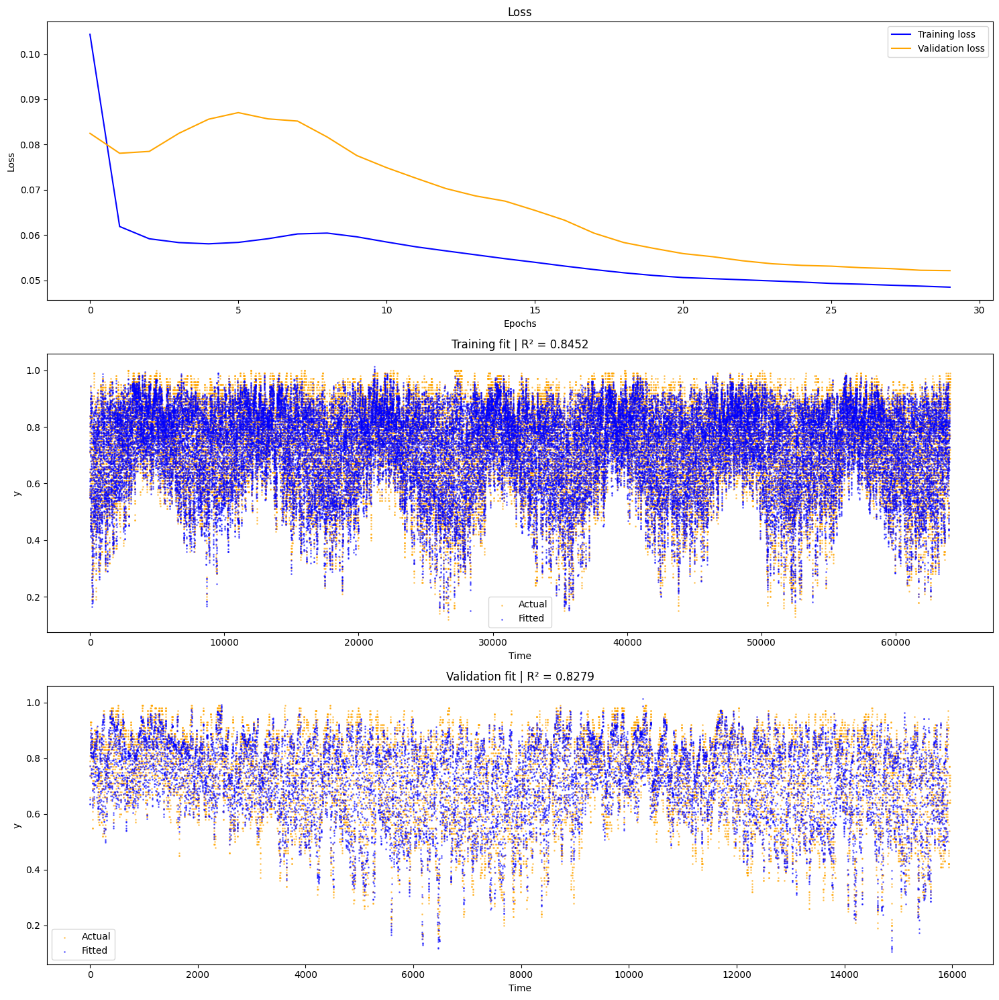

500/500 ━━━━━━━━━━━━━━━━━━━━ 6s 11ms/step
500/500 ━━━━━━━━━━━━━━━━━━━━ 6s 11ms/step
125/125 ━━━━━━━━━━━━━━━━━━━━ 2s 12ms/step
125/125 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step


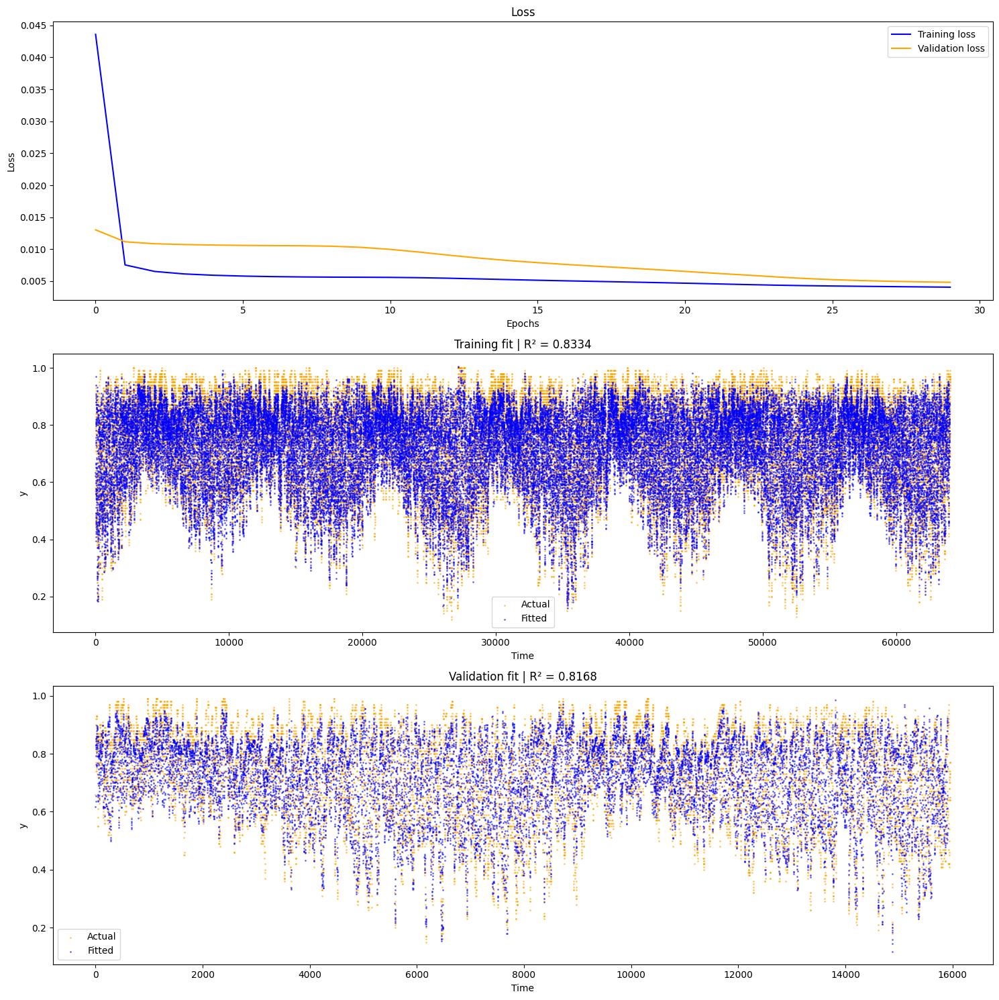

In [412]:
plot_lstm_results(best_model_mae)
plot_lstm_results(best_model_mse)

### 6 hours

In [27]:
print(best_params_mae)
print(best_params_mse)

{'lag': 48, 'sampling_rate': 1, 'batch_size': 128, 'neurons_per_layer': 32, 'hidden_layers': 2}
{'lag': 48, 'sampling_rate': 1, 'batch_size': 128, 'neurons_per_layer': 32, 'hidden_layers': 2}


In [415]:
mae_model_6h = fit_lstm(df_train, 6, 48, 1, 128, 32, 30, 2, "mae")

Model: "Weather_forcaster"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer_77 (InputLayer)     │ (None, 48, 14)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_204 (LSTM)                 │ (None, 32)             │         6,016 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_77 (Dense)                │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 6,049 (23.63 KB)

 Trainable params: 6,049 (23.63 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/30
500/500 ━━━━━━━━━━━━━━━━━━━━ 11s 19ms/step - loss: 0.2287 - val_loss: 0.1813
Epoch 2/30
500/500 ━━━━━━━━━━━━━━━━━━━━ 9s 17ms/step - loss: 0.0950 - val_loss: 0.1981
Epoch 3/30
500/500 ━━━━━━━━━━━━━━━━━━━━ 9s 18ms/step - loss: 0.0936 - val_loss: 0.1343
Epoch 4/30
500/500 ━━━━━━━━━━━━━━━━━━━━ 8s 15ms/step - loss: 0.0825 - val_loss: 0.0982
Epoch 5/30
500/500 ━━━━━━━━━━━━━━━━━━━━ 9s 17ms/step - loss: 0.0712 - val_loss: 0.1017
Epoch 6/30
500/500 ━━━━━━━━━━━━━━━━━━━━ 9s 19ms/step - loss: 0.0723 - val_loss: 0.1354
Epoch 7/30
500/500 ━━━━━━━━━━━━━━━━━━━━ 9s 19ms/step - loss: 0.0760 - val_loss: 0.1163
Epoch 8/30
500/500 ━━━━━━━━━━━━━━━━━━━━ 7s 15ms/step - loss: 0.0752 - val_loss: 0.1082
Epoch 9/30
500/500 ━━━━━━━━━━━━━━━━━━━━ 8s 16ms/step - loss: 0.0705 - val_loss: 0.0909
Epoch 10/30
500/500 ━━━━━━━━━━━━━━━━━━━━ 8s 17ms/step - loss: 0.0681 - val_loss: 0.0854
Epoch 11/30
500/500 ━━━━━━━━━━━━━━━━━━━━ 8s 16ms/step - loss: 0.0673 - val_loss: 0.0874
Epoch 12/30
500/500 ━━━━━━━━━━━━━━━━━━━━

500/500 ━━━━━━━━━━━━━━━━━━━━ 7s 14ms/step
500/500 ━━━━━━━━━━━━━━━━━━━━ 6s 11ms/step
125/125 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step
125/125 ━━━━━━━━━━━━━━━━━━━━ 1s 11ms/step


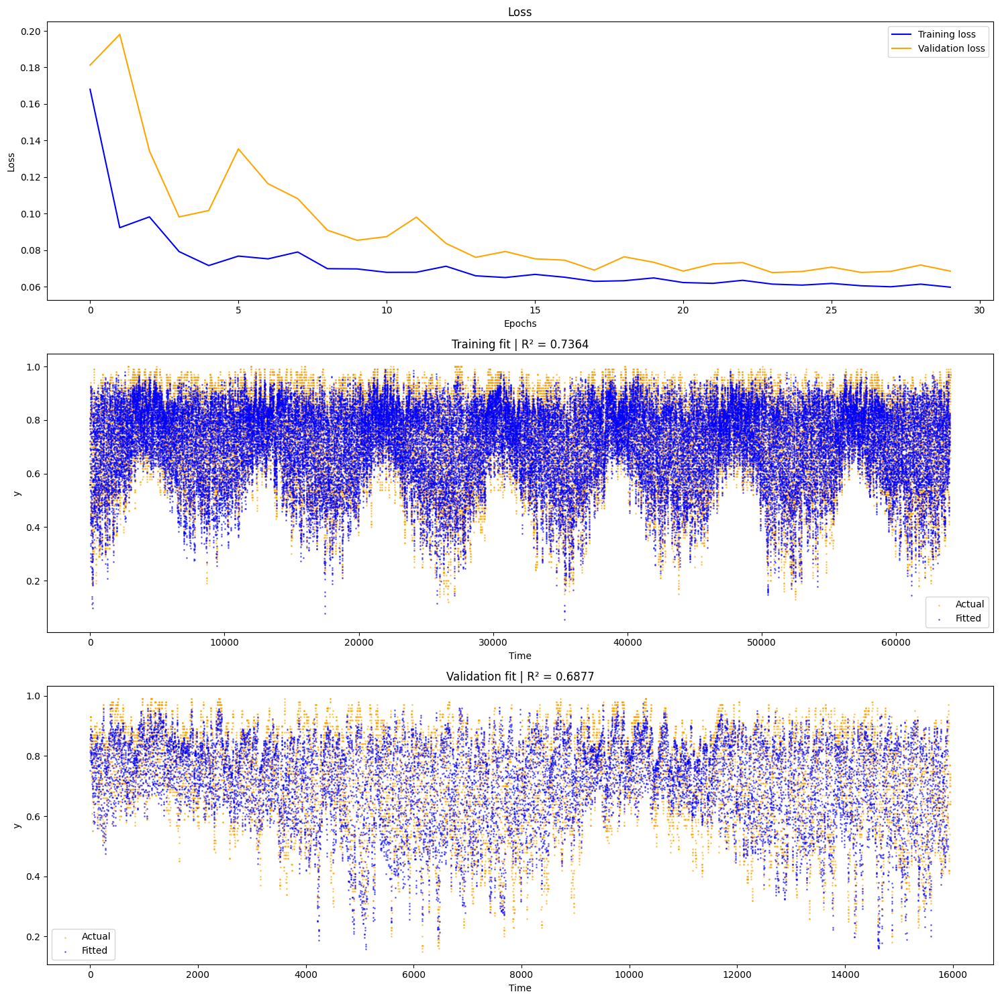

In [416]:
plot_lstm_results(mae_model_6h)

In [402]:
mse_model_6h = fit_lstm(df_train, 6, 48, 1, 128, 32, 30, 2, "mse")

Model: "Weather_forcaster"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer_73 (InputLayer)     │ (None, 48, 14)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_196 (LSTM)                 │ (None, 32)             │         6,016 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_73 (Dense)                │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 6,049 (23.63 KB)

 Trainable params: 6,049 (23.63 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/30
500/500 ━━━━━━━━━━━━━━━━━━━━ 10s 17ms/step - loss: 0.1142 - val_loss: 0.0159
Epoch 2/30
500/500 ━━━━━━━━━━━━━━━━━━━━ 7s 15ms/step - loss: 0.0112 - val_loss: 0.0155
Epoch 3/30
500/500 ━━━━━━━━━━━━━━━━━━━━ 9s 17ms/step - loss: 0.0099 - val_loss: 0.0314
Epoch 4/30
500/500 ━━━━━━━━━━━━━━━━━━━━ 8s 17ms/step - loss: 0.0113 - val_loss: 0.0144
Epoch 5/30
500/500 ━━━━━━━━━━━━━━━━━━━━ 7s 15ms/step - loss: 0.0088 - val_loss: 0.0276
Epoch 6/30
500/500 ━━━━━━━━━━━━━━━━━━━━ 7s 14ms/step - loss: 0.0103 - val_loss: 0.0185
Epoch 7/30
500/500 ━━━━━━━━━━━━━━━━━━━━ 7s 15ms/step - loss: 0.0092 - val_loss: 0.0879
Epoch 8/30
500/500 ━━━━━━━━━━━━━━━━━━━━ 8s 16ms/step - loss: 0.0140 - val_loss: 0.0513
Epoch 9/30
500/500 ━━━━━━━━━━━━━━━━━━━━ 8s 16ms/step - loss: 0.0122 - val_loss: 0.0219
Epoch 10/30
500/500 ━━━━━━━━━━━━━━━━━━━━ 8s 16ms/step - loss: 0.0093 - val_loss: 0.0174
Epoch 11/30
500/500 ━━━━━━━━━━━━━━━━━━━━ 8s 15ms/step - loss: 0.0085 - val_loss: 0.0138
Epoch 12/30
500/500 ━━━━━━━━━━━━━━━━━━━━

500/500 ━━━━━━━━━━━━━━━━━━━━ 6s 11ms/step
500/500 ━━━━━━━━━━━━━━━━━━━━ 5s 10ms/step
125/125 ━━━━━━━━━━━━━━━━━━━━ 1s 11ms/step
125/125 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step


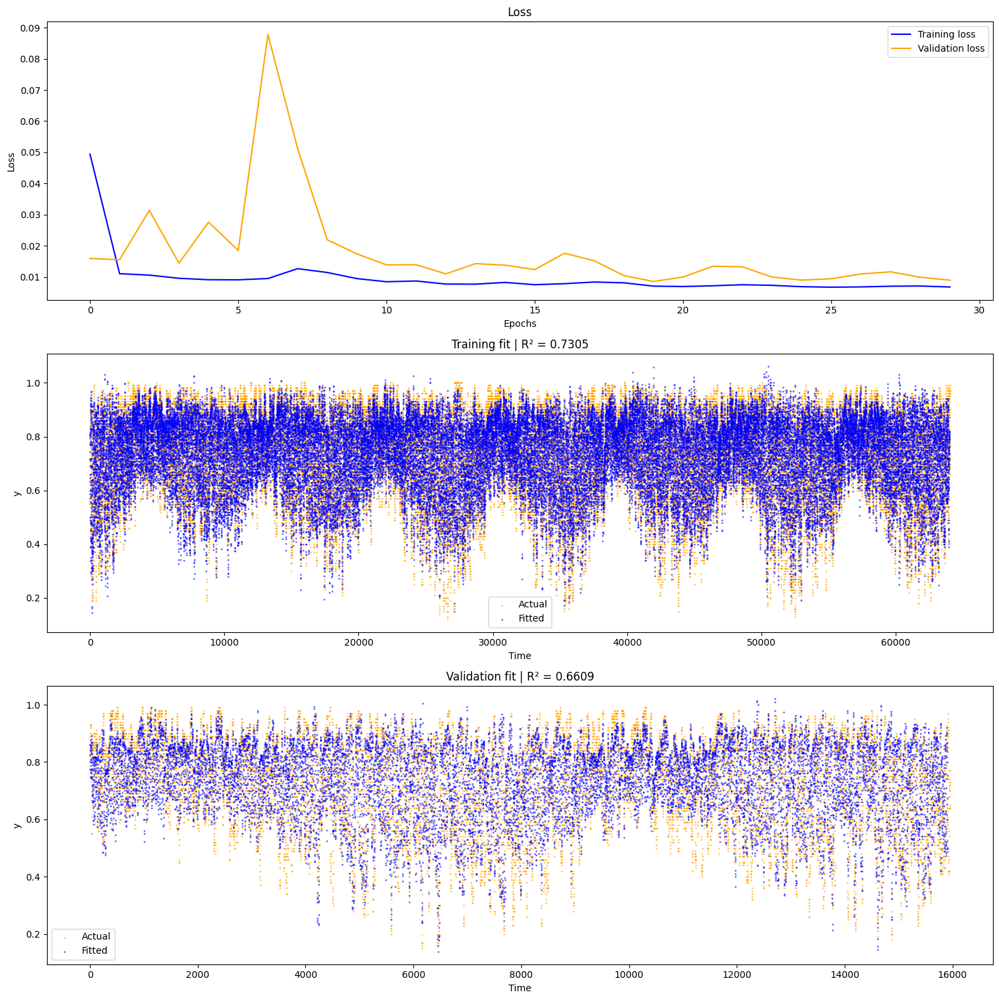

In [403]:
plot_lstm_results(mse_model_6h)

### 24 hours

In [404]:
mae_model_24h = fit_lstm(df_train, 24, 48, 1, 128, 32, 30, 2, "mae")

Model: "Weather_forcaster"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer_74 (InputLayer)     │ (None, 48, 14)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_198 (LSTM)                 │ (None, 32)             │         6,016 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_74 (Dense)                │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 6,049 (23.63 KB)

 Trainable params: 6,049 (23.63 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/30
500/500 ━━━━━━━━━━━━━━━━━━━━ 11s 19ms/step - loss: 0.2061 - val_loss: 0.2206
Epoch 2/30
500/500 ━━━━━━━━━━━━━━━━━━━━ 8s 15ms/step - loss: 0.1070 - val_loss: 0.1238
Epoch 3/30
500/500 ━━━━━━━━━━━━━━━━━━━━ 7s 15ms/step - loss: 0.0899 - val_loss: 0.1306
Epoch 4/30
500/500 ━━━━━━━━━━━━━━━━━━━━ 7s 15ms/step - loss: 0.0910 - val_loss: 0.1089
Epoch 5/30
500/500 ━━━━━━━━━━━━━━━━━━━━ 7s 14ms/step - loss: 0.0866 - val_loss: 0.0977
Epoch 6/30
500/500 ━━━━━━━━━━━━━━━━━━━━ 7s 14ms/step - loss: 0.0829 - val_loss: 0.0957
Epoch 7/30
500/500 ━━━━━━━━━━━━━━━━━━━━ 7s 14ms/step - loss: 0.0829 - val_loss: 0.1002
Epoch 8/30
500/500 ━━━━━━━━━━━━━━━━━━━━ 8s 16ms/step - loss: 0.0818 - val_loss: 0.0906
Epoch 9/30
500/500 ━━━━━━━━━━━━━━━━━━━━ 8s 15ms/step - loss: 0.0812 - val_loss: 0.0909
Epoch 10/30
500/500 ━━━━━━━━━━━━━━━━━━━━ 11s 22ms/step - loss: 0.0807 - val_loss: 0.0871
Epoch 11/30
500/500 ━━━━━━━━━━━━━━━━━━━━ 9s 19ms/step - loss: 0.0794 - val_loss: 0.0847
Epoch 12/30
500/500 ━━━━━━━━━━━━━━━━━━━

500/500 ━━━━━━━━━━━━━━━━━━━━ 10s 12ms/step
500/500 ━━━━━━━━━━━━━━━━━━━━ 6s 11ms/step
125/125 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step
125/125 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step


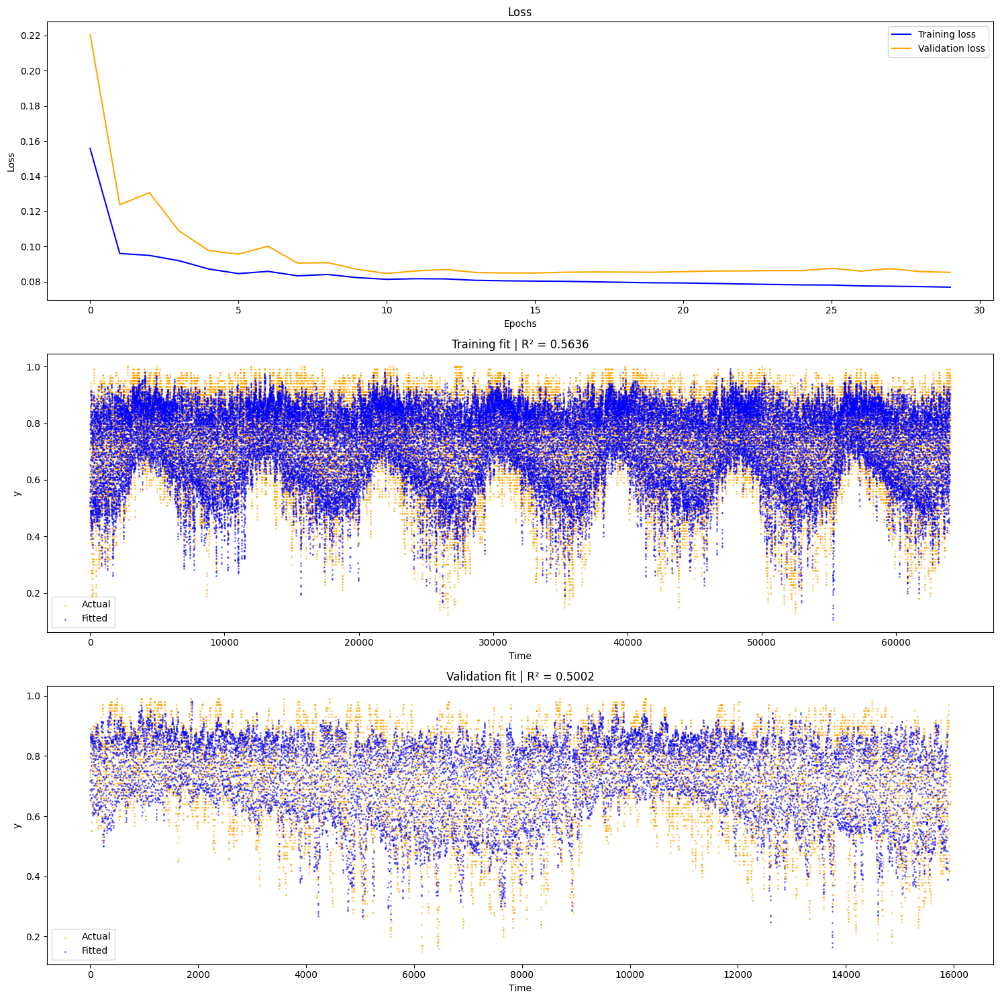

In [405]:
plot_lstm_results(mae_model_24h)

In [406]:
mse_model_24h = fit_lstm(df_train, 24, 48, 1, 128, 32, 30, 2, "mse")

Model: "Weather_forcaster"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer_75 (InputLayer)     │ (None, 48, 14)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_200 (LSTM)                 │ (None, 32)             │         6,016 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_75 (Dense)                │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 6,049 (23.63 KB)

 Trainable params: 6,049 (23.63 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/30
500/500 ━━━━━━━━━━━━━━━━━━━━ 9s 16ms/step - loss: 0.0509 - val_loss: 0.0356
Epoch 2/30
500/500 ━━━━━━━━━━━━━━━━━━━━ 7s 15ms/step - loss: 0.0177 - val_loss: 0.0220
Epoch 3/30
500/500 ━━━━━━━━━━━━━━━━━━━━ 8s 16ms/step - loss: 0.0140 - val_loss: 0.0208
Epoch 4/30
500/500 ━━━━━━━━━━━━━━━━━━━━ 9s 17ms/step - loss: 0.0126 - val_loss: 0.0158
Epoch 5/30
500/500 ━━━━━━━━━━━━━━━━━━━━ 8s 15ms/step - loss: 0.0116 - val_loss: 0.0133
Epoch 6/30
500/500 ━━━━━━━━━━━━━━━━━━━━ 7s 15ms/step - loss: 0.0114 - val_loss: 0.0165
Epoch 7/30
500/500 ━━━━━━━━━━━━━━━━━━━━ 7s 15ms/step - loss: 0.0117 - val_loss: 0.0133
Epoch 8/30
500/500 ━━━━━━━━━━━━━━━━━━━━ 8s 15ms/step - loss: 0.0112 - val_loss: 0.0154
Epoch 9/30
500/500 ━━━━━━━━━━━━━━━━━━━━ 7s 14ms/step - loss: 0.0114 - val_loss: 0.0156
Epoch 10/30
500/500 ━━━━━━━━━━━━━━━━━━━━ 7s 15ms/step - loss: 0.0114 - val_loss: 0.0181
Epoch 11/30
500/500 ━━━━━━━━━━━━━━━━━━━━ 7s 14ms/step - loss: 0.0114 - val_loss: 0.0202
Epoch 12/30
500/500 ━━━━━━━━━━━━━━━━━━━━ 

500/500 ━━━━━━━━━━━━━━━━━━━━ 5s 9ms/step
500/500 ━━━━━━━━━━━━━━━━━━━━ 5s 10ms/step
125/125 ━━━━━━━━━━━━━━━━━━━━ 1s 11ms/step
125/125 ━━━━━━━━━━━━━━━━━━━━ 1s 11ms/step


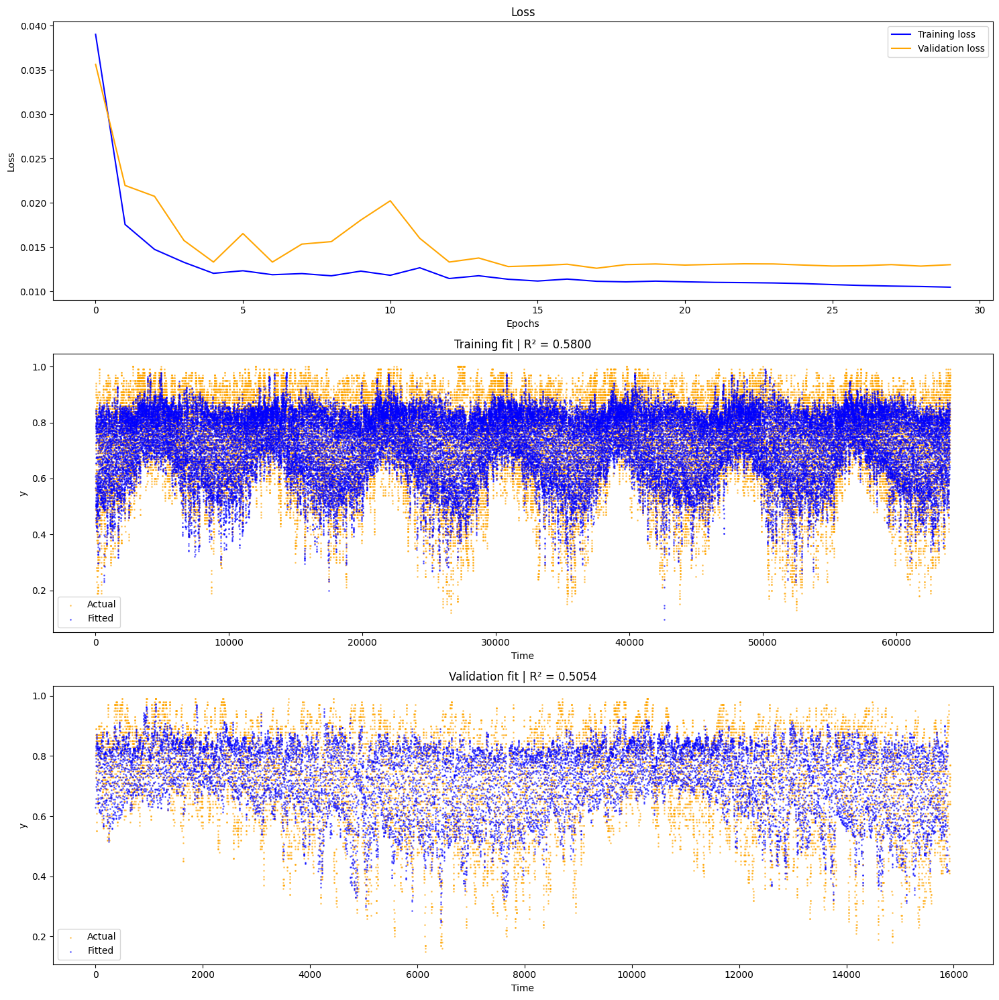

In [407]:
plot_lstm_results(mse_model_24h)

## Multi-step prediction

In this section, an LSTM model is trained to predict 8 features for the next 5 or 23 time periods. When predicting RH 6 hours, later, the 5-hour features predictor is used to predict the values of the 8 features at the next 5 time steps. Then, the 1-hour-ahead model is used to predict RH in the next hour based on the extended data set.

In [39]:
feats_list = ['temperature', 'wind_speed', 'mean_sea_level_pressure',
       'surface_solar_radiation', 'surface_thermal_radiation',
       'total_cloud_cover', 'low_p_dummy',
       'day_night_dummy']

In [40]:
def prepare_feature_prediction_data(df, feats_list, sequence_length=72, predict_steps=5):
    features = df[feats_list].values
    x, y = [], []

    for i in range(len(features) - sequence_length - predict_steps - 1):
        x_seq = features[i : i + sequence_length]
        y_seq = features[i + sequence_length : i + sequence_length + predict_steps]
        x.append(x_seq)
        y.append(y_seq.flatten())
    
    return np.array(x), np.array(y)

In [41]:
def build_feats_LSTM(input_shape, output_dim, neurons_per_layer, hidden_layers, loss):
    inputs = keras.layers.Input(shape=input_shape)
    
    x = keras.layers.LSTM(neurons_per_layer, return_sequences=True)(inputs)
    
    for _ in range(hidden_layers - 2):  # all but last hidden layer
        x = keras.layers.LSTM(neurons_per_layer, return_sequences=True)(x)
    
    # Final LSTM layer: return_sequences=False
    x = keras.layers.LSTM(neurons_per_layer, return_sequences=False)(x)

    # Final Dense output
    outputs = keras.layers.Dense(output_dim)(x)
    
    model = keras.Model(inputs, outputs, name="Feature_Predictor")
    model.compile(optimizer='adam', loss=loss)
    return model


In [47]:
def fit_feats_LSTM(data, feats_list, sequence_length, predict_steps, batch_size, epochs, neurons_per_layer, hidden_layers, loss):
    """
    Train an LSTM model to predict features for the next time steps.

    Parameters:
    - data: DataFrame containing the features.
    - feats_list: List of feature column names to use for training.
    - sequence_length: Number of past time steps to consider.
    - predict_steps: Number of future time steps to predict.
    - batch_size: Batch size for training.
    - epochs: Number of epochs for training.
    - neurons_per_layer: Number of neurons in each LSTM layer.
    - hidden_layers: Number of hidden LSTM layers.
    - loss: Loss function to use for training.

    Returns:
    - model: Trained LSTM model.
    - history: Training history of the model.
    - x_train, y_train, x_test, y_test: Training and testing datasets.
    """
    # Prepare the data for feature prediction
    x, y = prepare_feature_prediction_data(data, feats_list, sequence_length, predict_steps)

    # Split the data into training and testing sets
    cutoff = int(len(x) * 0.8)
    x_train, y_train = x[:cutoff], y[:cutoff]
    x_test, y_test = x[cutoff:], y[cutoff:]

    # Build the LSTM model
    input_shape = (sequence_length, len(feats_list))
    output_dim = predict_steps * len(feats_list)
    model = build_feats_LSTM(input_shape, output_dim, neurons_per_layer, hidden_layers, loss)

    # Train the model
    history = model.fit(
        x_train, y_train,
        validation_split=0.1,
        epochs=epochs,
        batch_size=batch_size
    )

    return model, history, x_train, y_train, x_test, y_test

In [48]:
def train_feature_forecasting_model(
    data, feats_list, sequence_length=72, predict_steps=5,
    batch_size=64, epochs=10, neurons_per_layer=64, hidden_layers=2, loss='mae'
):
    """
    Trains an LSTM model to predict future feature values.

    Returns:
    - trained model
    - sequence_length, predict_steps (for use in future prediction)
    - feats_list (to ensure consistent column ordering)
    """
    model, history, x_train, y_train, x_test, y_test = fit_feats_LSTM(
        data, feats_list, sequence_length, predict_steps,
        batch_size, epochs, neurons_per_layer, hidden_layers, loss
    )
    return model, sequence_length, predict_steps, feats_list


In [49]:
def extend_dataframe_with_predictions(
    model, df, feats_list, sequence_length, predict_steps
):
    """
    Uses a trained model to predict the next N steps of features
    and appends them to the dataframe.

    Returns:
    - extended_df with appended predicted rows
    """
    # Extract the latest input sequence from the dataframe
    latest_sequence = df[feats_list].values[-sequence_length:]
    latest_sequence = latest_sequence.reshape(1, sequence_length, len(feats_list))

    # Predict future values
    prediction = model.predict(latest_sequence)
    prediction = prediction.reshape(predict_steps, len(feats_list))

    # Create dataframe for predicted rows
    predicted_df = pd.DataFrame(prediction, columns=feats_list)
    predicted_df.index = range(len(df), len(df) + predict_steps)

    # Concatenate with original dataframe
    extended_df = pd.concat([df, predicted_df], ignore_index=True)

    return extended_df


In [ ]:
feats_model, seq_len, pred_steps, feats = train_feature_forecasting_model(
    data=df_train[:int(cutoff*0.8)],
    feats_list=feats_list,
    sequence_length=48,
    predict_steps=5,
    epochs=20
)


Epoch 1/20
720/720 ━━━━━━━━━━━━━━━━━━━━ 25s 32ms/step - loss: 0.2981 - val_loss: 0.1769
Epoch 2/20
720/720 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - loss: 0.1545 - val_loss: 0.1626
Epoch 3/20
720/720 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - loss: 0.1451 - val_loss: 0.1573
Epoch 4/20
720/720 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - loss: 0.1411 - val_loss: 0.1542
Epoch 5/20
720/720 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - loss: 0.1393 - val_loss: 0.1525
Epoch 6/20
720/720 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - loss: 0.1375 - val_loss: 0.1523
Epoch 7/20
720/720 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - loss: 0.1358 - val_loss: 0.1511
Epoch 8/20
720/720 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - loss: 0.1341 - val_loss: 0.1491
Epoch 9/20
720/720 ━━━━━━━━━━━━━━━━━━━━ 21s 29ms/step - loss: 0.1337 - val_loss: 0.1479
Epoch 10/20
720/720 ━━━━━━━━━━━━━━━━━━━━ 23s 32ms/step - loss: 0.1314 - val_loss: 0.1482
Epoch 11/20
720/720 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - loss: 0.1302 - val_loss: 0.1452
Epoch 12/20
720/720 ━━━━━━━━━━

In [53]:
def rolling_rh_forecast_on_validation_np(
    feats_model,
    rh_model,
    val_df,
    feats_list,
    sequence_length,
    predict_steps,
    batch_size=1
):
    """
    Performs rolling 1-step-ahead prediction of RH using the feature model + RH model.
    This modification predicts 2 values, and only the first one is extracted and used.

    Returns:
    - NumPy array of predicted RH values.
    """
    predicted_rh_list = []

    for i in range(72, len(val_df)-predict_steps):
        # Slice current observed window
        current_df = val_df.iloc[i - 48:i].copy()  # Ensure we get the correct slice

        # Extend with predicted features
        extended_df = extend_dataframe_with_predictions(
            model=feats_model,
            df=current_df,
            feats_list=feats_list,
            sequence_length=48,
            predict_steps=predict_steps
        )
        extended_df = extended_df[feats_list]
        extended_df = extended_df[predict_steps + 48 - sequence_length:].values

        # Create time-series dataset for RH model
        dataset_rh = tf.keras.preprocessing.timeseries_dataset_from_array(
            data=extended_df,
            targets=None,  # No targets for RH model prediction
            sequence_length=sequence_length,  
            sampling_rate=1,
            batch_size=batch_size,  # One batch at a time
        )

        # Predict RH using the RH model
        predicted_rh = rh_model.predict(dataset_rh)
        
        # If the model returns a tuple, get the first element (predictions)
        if isinstance(predicted_rh, tuple):
            predicted_rh = predicted_rh[0]  # Extract predictions from the tuple
            
        print(f"Predicted RH for index {i}: {predicted_rh}")
        predicted_rh_list.append(predicted_rh[0])  # Append the first predicted value from the batch

    return np.array(predicted_rh_list)

### 6 hours

In [262]:
# Call the function with your specific parameters
rh_preds = rolling_rh_forecast_on_validation_np(
    feats_model=feats_model,
    rh_model=best_model_mae[2],
    val_df=df_train[int(cutoff*0.8):],
    feats_list=feats_list,
    sequence_length=48,
    predict_steps=5
)

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
Predicted RH for index 72: [[0.8139845]]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
Predicted RH for index 73: [[0.81852627]]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
Predicted RH for index 74: [[0.87568843]]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
Predicted RH for index 75: [[0.87635684]]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step
Predicted RH for index 76: [[0.8994875]]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
Predicted RH for index 77: [[0.8986149]]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
Predicted RH for index 78: [[0.88590646]]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 41ms/step
Predicted RH for index 79: [[0.8515277]]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━

MAE of RH predictions: 0.06637328320630166
R² of RH predictions: 0.7145537593137344


Text(0.5, 1.0, 'Multi-step LSTM 6-hour Prediction (Validation) | R²: 0.7146')

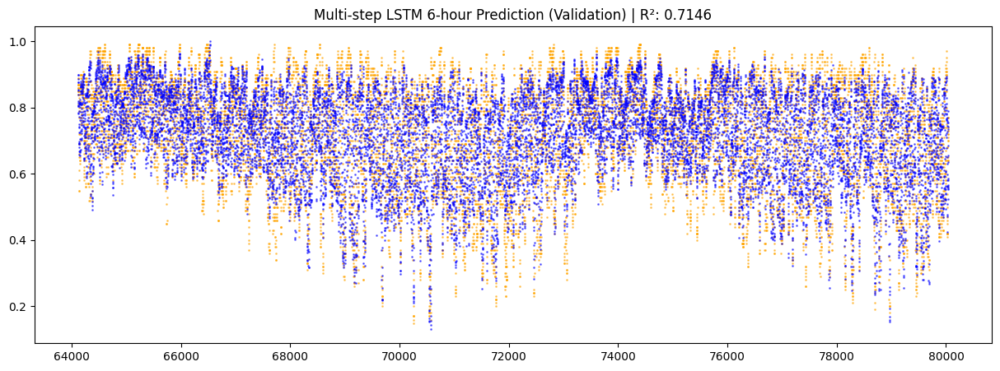

In [375]:
mae_value_rh_preds_6h = mean_absolute_error(df_train[int(cutoff*0.8+77):]['relative_humidity'].values, rh_preds)
r2_score_rh_preds_6h = r2_score(df_train[int(cutoff*0.8+77):]['relative_humidity'].values, rh_preds)
print(f"MAE of RH predictions: {mae_value_rh_preds_6h}")
print(f"R² of RH predictions: {r2_score_rh_preds_6h}")

# Plotting the results
plt.figure(figsize=(15, 5))
plt.scatter(df_train.index[int(cutoff*0.8+77):], df_train[int(cutoff*0.8+77):]['relative_humidity'].values, label='Actual RH', color='orange', alpha = 0.5, s = 1)
plt.scatter(df_train.index[int(cutoff*0.8+77):], rh_preds, label='Predicted RH', color='blue', alpha = 0.5, s = 1)
plt.title('Multi-step LSTM 6-hour Prediction (Validation) | R²: {:.4f}'.format(r2_score_rh_preds_6h))

### 24 hours

In [315]:
feats_model_24h = train_feature_forecasting_model(
    data=df_train[:int(cutoff*0.8)],
    feats_list=feats_list,
    sequence_length=72,
    predict_steps=23,
    epochs=20
)

Epoch 1/20
720/720 ━━━━━━━━━━━━━━━━━━━━ 38s 48ms/step - loss: 0.3739 - val_loss: 0.3058
Epoch 2/20
720/720 ━━━━━━━━━━━━━━━━━━━━ 33s 46ms/step - loss: 0.2615 - val_loss: 0.2863
Epoch 3/20
720/720 ━━━━━━━━━━━━━━━━━━━━ 33s 46ms/step - loss: 0.2492 - val_loss: 0.2810
Epoch 4/20
720/720 ━━━━━━━━━━━━━━━━━━━━ 33s 46ms/step - loss: 0.2419 - val_loss: 0.2770
Epoch 5/20
720/720 ━━━━━━━━━━━━━━━━━━━━ 33s 46ms/step - loss: 0.2371 - val_loss: 0.2767
Epoch 6/20
720/720 ━━━━━━━━━━━━━━━━━━━━ 52s 72ms/step - loss: 0.2341 - val_loss: 0.2757
Epoch 7/20
720/720 ━━━━━━━━━━━━━━━━━━━━ 67s 94ms/step - loss: 0.2294 - val_loss: 0.2772
Epoch 8/20
720/720 ━━━━━━━━━━━━━━━━━━━━ 65s 90ms/step - loss: 0.2257 - val_loss: 0.2774
Epoch 9/20
720/720 ━━━━━━━━━━━━━━━━━━━━ 65s 90ms/step - loss: 0.2213 - val_loss: 0.2754
Epoch 10/20
720/720 ━━━━━━━━━━━━━━━━━━━━ 57s 80ms/step - loss: 0.2170 - val_loss: 0.2831
Epoch 11/20
720/720 ━━━━━━━━━━━━━━━━━━━━ 43s 60ms/step - loss: 0.2192 - val_loss: 0.2792
Epoch 12/20
720/720 ━━━━━━━━━━

In [ ]:
# Call the function with your specific parameters
rh_preds_24h = rolling_rh_forecast_on_validation_np(
    feats_model=feats_model_24h[0],
    rh_model=best_model_mae[2],
    val_df=df_train[int(cutoff*0.8):],
    feats_list=feats_list,
    sequence_length=48,
    predict_steps=23
)

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 556ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step
Predicted RH for index 72: [[0.62095296]]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
Predicted RH for index 73: [[0.6176045]]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
Predicted RH for index 74: [[0.63172424]]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
Predicted RH for index 75: [[0.63831913]]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
Predicted RH for index 76: [[0.64870524]]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
Predicted RH for index 77: [[0.7030152]]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
Predicted RH for index 78: [[0.7377509]]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
Predicted RH for index 79: [[0.7628499]]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━

MAE of RH predictions: 0.09087654313209503
R² of RH predictions: 0.4612824938283794


Text(0.5, 1.0, 'Multi-step LSTM 24-hour Prediction (Validation) | R²: 0.4613')

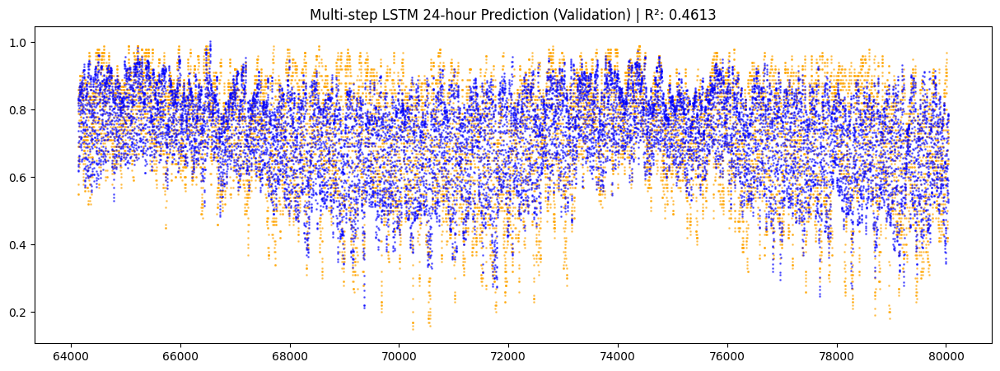

In [374]:
mae_value_rh_preds_24h = mean_absolute_error(df_train[int(cutoff*0.8+95):]['relative_humidity'].values, rh_preds_24h)
r2_score_rh_preds_24h = r2_score(df_train[int(cutoff*0.8+95):]['relative_humidity'].values, rh_preds_24h)
print(f"MAE of RH predictions: {mae_value_rh_preds_24h}")
print(f"R² of RH predictions: {r2_score_rh_preds_24h}")

# Plotting the results
plt.figure(figsize=(15, 5))
plt.scatter(df_train.index[int(cutoff*0.8+95):], df_train[int(cutoff*0.8+95):]['relative_humidity'].values, label='Actual RH', color='orange', alpha = 0.5, s = 1)
plt.scatter(df_train.index[int(cutoff*0.8+95):], rh_preds_24h, label='Predicted RH', color='blue', alpha = 0.5, s = 1)
plt.title('Multi-step LSTM 24-hour Prediction (Validation) | R²: {:.4f}'.format(r2_score_rh_preds_24h))

## Adding new features

In [408]:
from statsmodels.tsa.seasonal import MSTL

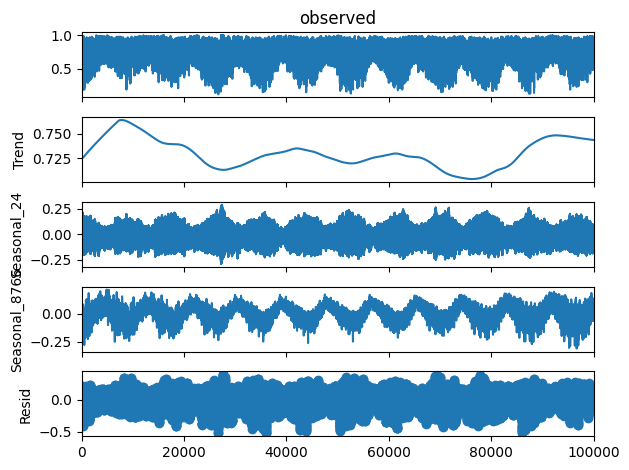

<Figure size 2500x1000 with 0 Axes>

In [410]:
res = MSTL(df_final['relative_humidity'], periods=(24, 8766)).fit()
figure = res.plot()
plt.figure(figsize=(25, 10), linewidth=0.5)
plt.tight_layout()
plt.show()

We observe strong seasonality and an irregular trend emerging in relative humidity. Following this, we focus on daily and yearly seasonality in the added features.

In [15]:
def add_fourier_time_features(df, time_col='date_time', periods=[24, 8766]):
    """
    Adds Fourier components (sine and cosine) for given periods to the dataframe.
    """
    df = df.copy()  # Prevent SettingWithCopyWarning

    # Convert datetime to hours since epoch
    timestamp_hours = df[time_col].astype(np.int64) // 10**9 // 3600

    for period in periods:
        df[f'sin_time_{period}'] = np.sin(2 * np.pi * timestamp_hours / period)
        df[f'cos_time_{period}'] = np.cos(2 * np.pi * timestamp_hours / period)

    return df


In [382]:
new_df_train = add_fourier_time_features(df_train)

### 1 hour

In [385]:
new_lstm_mae_1h = fit_lstm(new_df_train, 1, 48, 1, 64, 32, 30, 2, "mae")

Model: "Weather_forcaster"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer_65 (InputLayer)     │ (None, 48, 14)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_180 (LSTM)                 │ (None, 32)             │         6,016 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_65 (Dense)                │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 6,049 (23.63 KB)

 Trainable params: 6,049 (23.63 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/30
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 14s 11ms/step - loss: 0.1343 - val_loss: 0.3153
Epoch 2/30
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 11s 11ms/step - loss: 0.0743 - val_loss: 0.1695
Epoch 3/30
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 14s 14ms/step - loss: 0.0688 - val_loss: 0.1134
Epoch 4/30
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 12s 12ms/step - loss: 0.0598 - val_loss: 0.0690
Epoch 5/30
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 11s 11ms/step - loss: 0.0546 - val_loss: 0.0645
Epoch 6/30
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 10s 10ms/step - loss: 0.0542 - val_loss: 0.0698
Epoch 7/30
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 13s 13ms/step - loss: 0.0532 - val_loss: 0.0631
Epoch 8/30
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 11s 11ms/step - loss: 0.0520 - val_loss: 0.0551
Epoch 9/30
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 11s 11ms/step - loss: 0.0509 - val_loss: 0.0634
Epoch 10/30
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 12s 12ms/step - loss: 0.0512 - val_loss: 0.0686
Epoch 11/30
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 11s 11ms/step - loss: 0.0514 - val_loss: 0.0686
Epoch 12

1000/1000 ━━━━━━━━━━━━━━━━━━━━ 6s 6ms/step
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 6s 6ms/step
249/249 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
249/249 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step


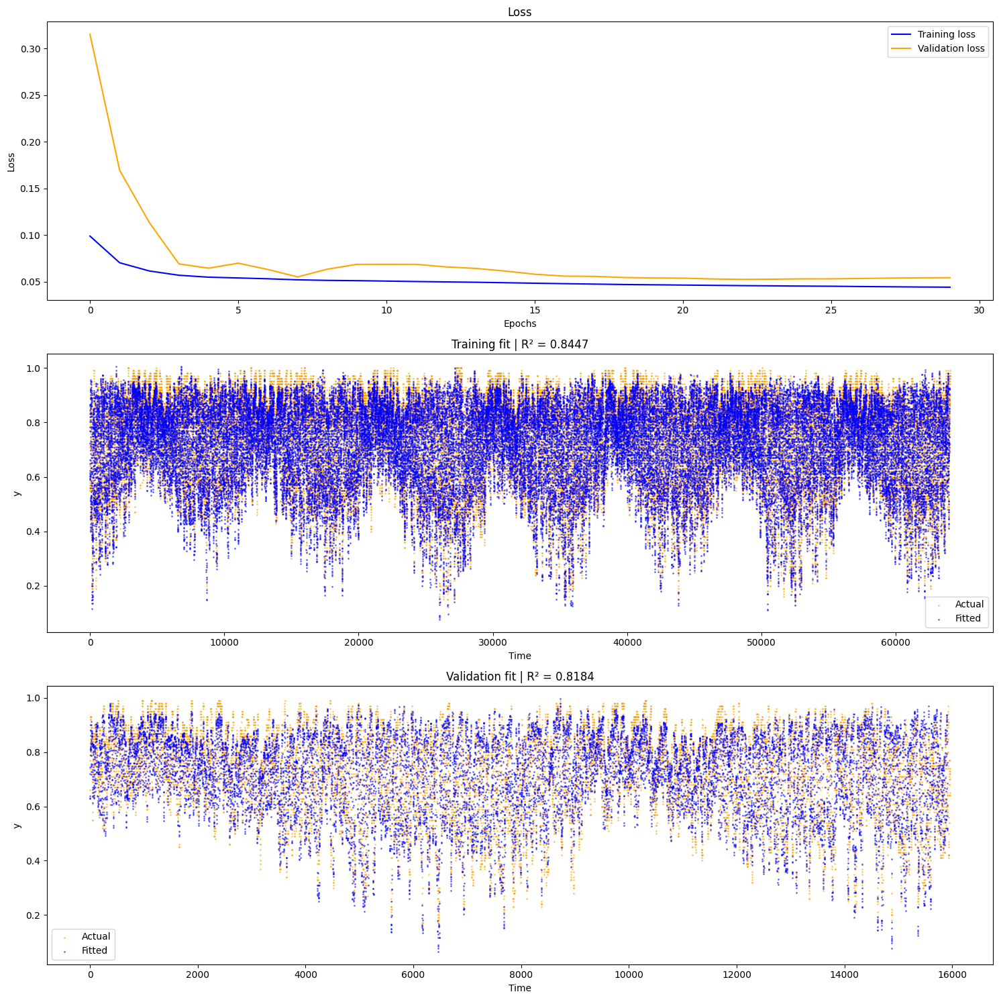

In [386]:
plot_lstm_results(new_lstm_mae_1h)

In [387]:
new_lstm_mse_1h = fit_lstm(new_df_train, 1, 48, 1, 64, 32, 30, 2, "mse")

Model: "Weather_forcaster"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer_66 (InputLayer)     │ (None, 48, 14)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_182 (LSTM)                 │ (None, 32)             │         6,016 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_66 (Dense)                │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 6,049 (23.63 KB)

 Trainable params: 6,049 (23.63 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/30
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 13s 11ms/step - loss: 0.0526 - val_loss: 0.0627
Epoch 2/30
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 12s 11ms/step - loss: 0.0073 - val_loss: 0.0628
Epoch 3/30
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 11s 11ms/step - loss: 0.0066 - val_loss: 0.0463
Epoch 4/30
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 11s 11ms/step - loss: 0.0064 - val_loss: 0.0265
Epoch 5/30
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 11s 11ms/step - loss: 0.0059 - val_loss: 0.0119
Epoch 6/30
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 11s 11ms/step - loss: 0.0051 - val_loss: 0.0077
Epoch 7/30
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 12s 12ms/step - loss: 0.0046 - val_loss: 0.0092
Epoch 8/30
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 11s 11ms/step - loss: 0.0045 - val_loss: 0.0130
Epoch 9/30
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 13s 13ms/step - loss: 0.0045 - val_loss: 0.0153
Epoch 10/30
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 11s 11ms/step - loss: 0.0045 - val_loss: 0.0148
Epoch 11/30
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 11s 11ms/step - loss: 0.0044 - val_loss: 0.0137
Epoch 12

1000/1000 ━━━━━━━━━━━━━━━━━━━━ 5s 5ms/step
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 5s 5ms/step
249/249 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
249/249 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step


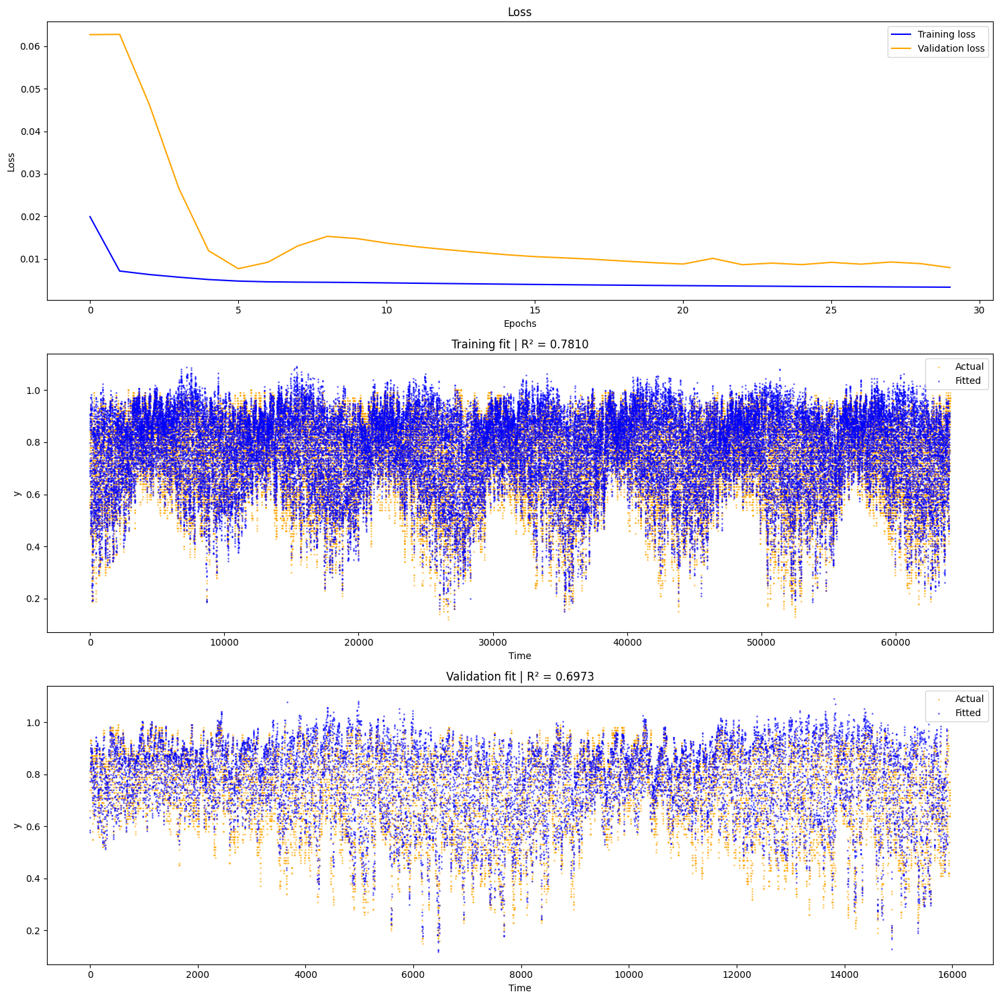

In [388]:
plot_lstm_results(new_lstm_mse_1h)

### 6 hours

In [389]:
new_lstm_mae_6h = fit_lstm(new_df_train, 6, 48, 1, 64, 32, 30, 2, "mae")

Model: "Weather_forcaster"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer_67 (InputLayer)     │ (None, 48, 14)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_184 (LSTM)                 │ (None, 32)             │         6,016 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_67 (Dense)                │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 6,049 (23.63 KB)

 Trainable params: 6,049 (23.63 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/30
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 11s 10ms/step - loss: 0.1143 - val_loss: 0.1534
Epoch 2/30
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 9s 9ms/step - loss: 0.0813 - val_loss: 0.0894
Epoch 3/30
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 10s 10ms/step - loss: 0.0706 - val_loss: 0.0892
Epoch 4/30
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 9s 9ms/step - loss: 0.0695 - val_loss: 0.0790
Epoch 5/30
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 10s 10ms/step - loss: 0.0685 - val_loss: 0.0736
Epoch 6/30
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 11s 11ms/step - loss: 0.0666 - val_loss: 0.0745
Epoch 7/30
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 10s 10ms/step - loss: 0.0656 - val_loss: 0.0710
Epoch 8/30
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 10s 10ms/step - loss: 0.0646 - val_loss: 0.0708
Epoch 9/30
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 10s 10ms/step - loss: 0.0637 - val_loss: 0.0715
Epoch 10/30
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 11s 11ms/step - loss: 0.0630 - val_loss: 0.0703
Epoch 11/30
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 10s 10ms/step - loss: 0.0620 - val_loss: 0.0698
Epoch 12/30


1000/1000 ━━━━━━━━━━━━━━━━━━━━ 5s 5ms/step
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 5s 5ms/step
249/249 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
249/249 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step


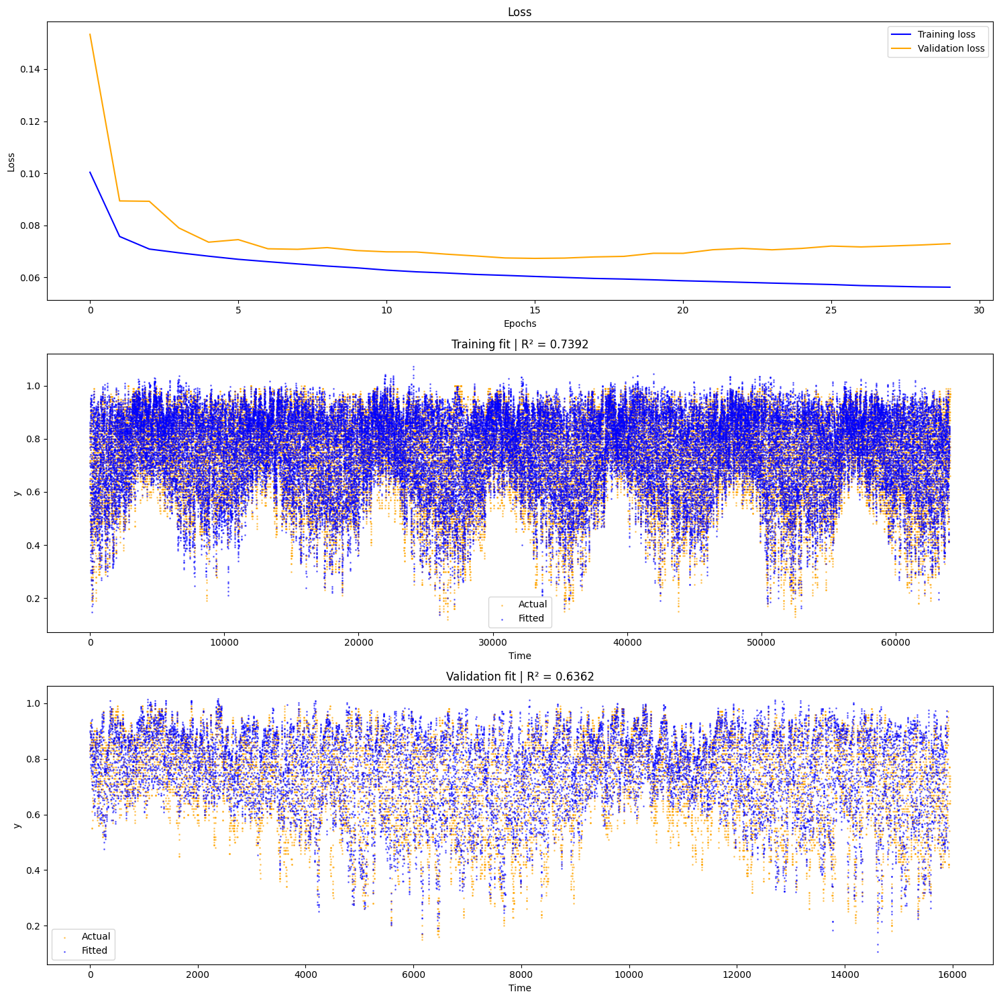

In [390]:
plot_lstm_results(new_lstm_mae_6h)

In [391]:
new_lstm_mse_6h = fit_lstm(new_df_train, 6, 48, 1, 64, 32, 30, 2, "mse")

Model: "Weather_forcaster"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer_68 (InputLayer)     │ (None, 48, 14)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_186 (LSTM)                 │ (None, 32)             │         6,016 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_68 (Dense)                │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 6,049 (23.63 KB)

 Trainable params: 6,049 (23.63 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/30
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 12s 10ms/step - loss: 0.0472 - val_loss: 0.0329
Epoch 2/30
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 10s 10ms/step - loss: 0.0098 - val_loss: 0.0281
Epoch 3/30
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 10s 10ms/step - loss: 0.0089 - val_loss: 0.0173
Epoch 4/30
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 10s 10ms/step - loss: 0.0082 - val_loss: 0.0118
Epoch 5/30
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 9s 9ms/step - loss: 0.0078 - val_loss: 0.0099
Epoch 6/30
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 10s 10ms/step - loss: 0.0075 - val_loss: 0.0102
Epoch 7/30
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 9s 9ms/step - loss: 0.0073 - val_loss: 0.0110
Epoch 8/30
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 10s 10ms/step - loss: 0.0072 - val_loss: 0.0122
Epoch 9/30
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 9s 9ms/step - loss: 0.0071 - val_loss: 0.0136
Epoch 10/30
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 9s 9ms/step - loss: 0.0071 - val_loss: 0.0144
Epoch 11/30
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 9s 9ms/step - loss: 0.0070 - val_loss: 0.0139
Epoch 12/30
1000/1

1000/1000 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 5s 5ms/step
249/249 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
249/249 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step


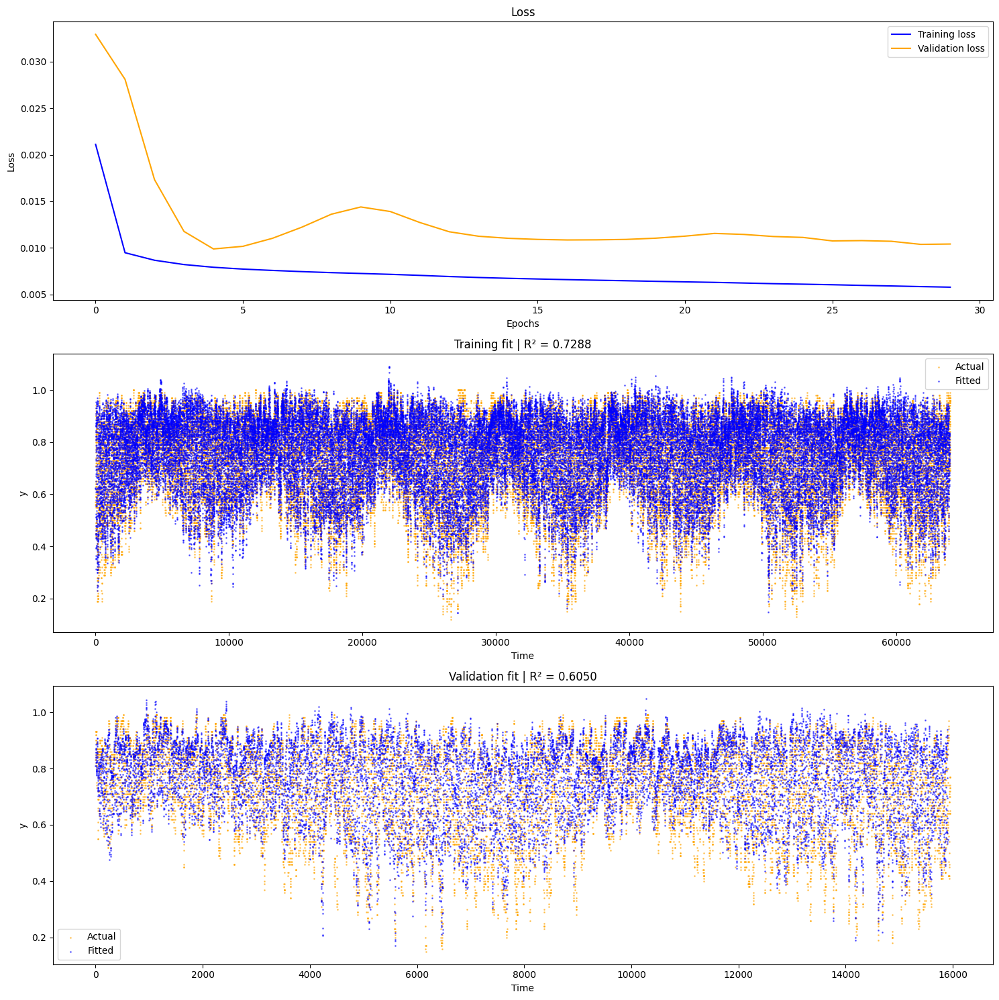

In [392]:
plot_lstm_results(new_lstm_mse_6h)

### 24 hours

In [397]:
new_lstm_mae_24h_128 = fit_lstm(new_df_train, 24, 48, 1, 128, 32, 30, 2, "mae")

Model: "Weather_forcaster"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer_71 (InputLayer)     │ (None, 48, 14)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_192 (LSTM)                 │ (None, 32)             │         6,016 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_71 (Dense)                │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 6,049 (23.63 KB)

 Trainable params: 6,049 (23.63 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/30
500/500 ━━━━━━━━━━━━━━━━━━━━ 11s 18ms/step - loss: 0.2193 - val_loss: 0.1748
Epoch 2/30
500/500 ━━━━━━━━━━━━━━━━━━━━ 9s 18ms/step - loss: 0.1014 - val_loss: 0.1929
Epoch 3/30
500/500 ━━━━━━━━━━━━━━━━━━━━ 9s 19ms/step - loss: 0.0944 - val_loss: 0.1649
Epoch 4/30
500/500 ━━━━━━━━━━━━━━━━━━━━ 9s 17ms/step - loss: 0.0946 - val_loss: 0.1006
Epoch 5/30
500/500 ━━━━━━━━━━━━━━━━━━━━ 11s 21ms/step - loss: 0.0845 - val_loss: 0.1068
Epoch 6/30
500/500 ━━━━━━━━━━━━━━━━━━━━ 9s 17ms/step - loss: 0.0846 - val_loss: 0.0982
Epoch 7/30
500/500 ━━━━━━━━━━━━━━━━━━━━ 9s 17ms/step - loss: 0.0831 - val_loss: 0.1137
Epoch 8/30
500/500 ━━━━━━━━━━━━━━━━━━━━ 11s 21ms/step - loss: 0.0831 - val_loss: 0.0976
Epoch 9/30
500/500 ━━━━━━━━━━━━━━━━━━━━ 8s 17ms/step - loss: 0.0819 - val_loss: 0.0869
Epoch 10/30
500/500 ━━━━━━━━━━━━━━━━━━━━ 8s 16ms/step - loss: 0.0807 - val_loss: 0.0933
Epoch 11/30
500/500 ━━━━━━━━━━━━━━━━━━━━ 10s 20ms/step - loss: 0.0801 - val_loss: 0.0886
Epoch 12/30
500/500 ━━━━━━━━━━━━━━━━━

500/500 ━━━━━━━━━━━━━━━━━━━━ 6s 10ms/step
500/500 ━━━━━━━━━━━━━━━━━━━━ 5s 10ms/step
125/125 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step
125/125 ━━━━━━━━━━━━━━━━━━━━ 1s 11ms/step


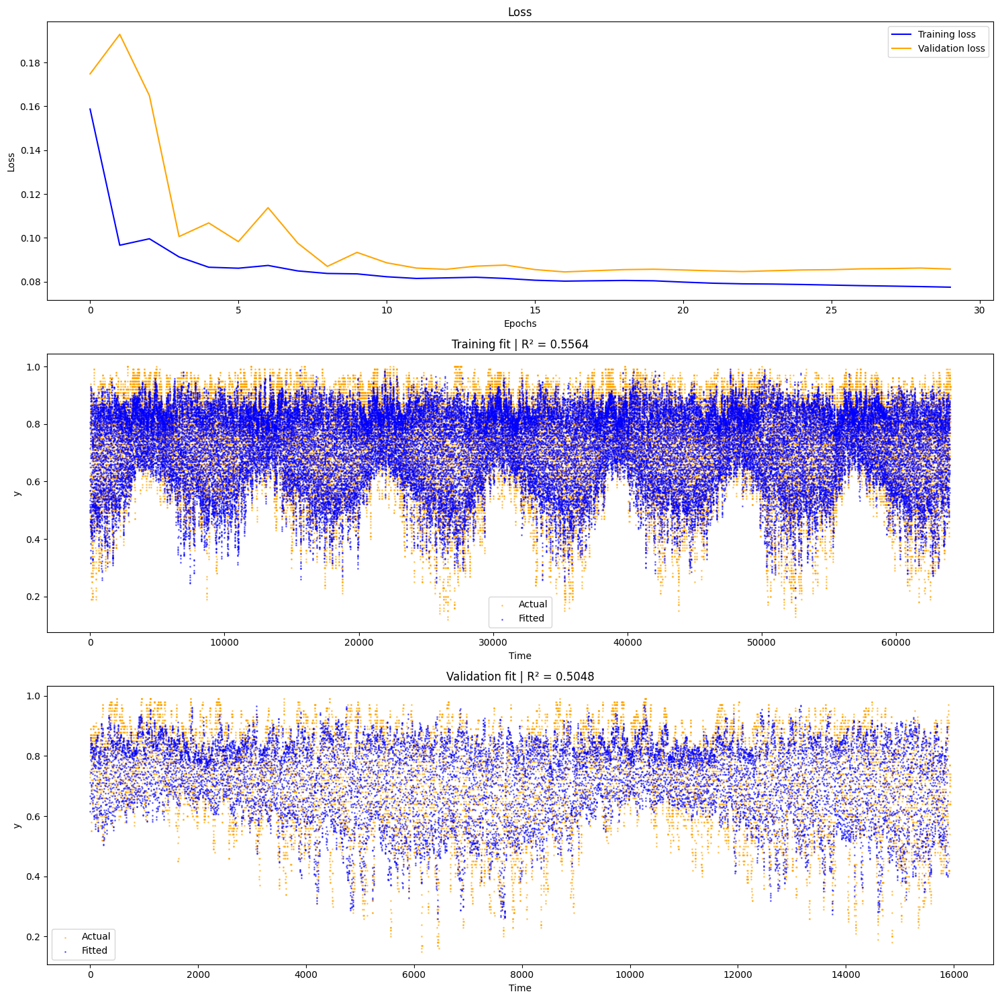

In [398]:
plot_lstm_results(new_lstm_mae_24h_128)

In [399]:
new_lstm_mse_24h_128 = fit_lstm(new_df_train, 24, 48, 1, 128, 32, 30, 2, "mse")

Model: "Weather_forcaster"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer_72 (InputLayer)     │ (None, 48, 14)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_194 (LSTM)                 │ (None, 32)             │         6,016 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_72 (Dense)                │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 6,049 (23.63 KB)

 Trainable params: 6,049 (23.63 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/30
500/500 ━━━━━━━━━━━━━━━━━━━━ 10s 16ms/step - loss: 0.0995 - val_loss: 0.0469
Epoch 2/30
500/500 ━━━━━━━━━━━━━━━━━━━━ 8s 16ms/step - loss: 0.0174 - val_loss: 0.0227
Epoch 3/30
500/500 ━━━━━━━━━━━━━━━━━━━━ 8s 16ms/step - loss: 0.0135 - val_loss: 0.0228
Epoch 4/30
500/500 ━━━━━━━━━━━━━━━━━━━━ 8s 16ms/step - loss: 0.0131 - val_loss: 0.0175
Epoch 5/30
500/500 ━━━━━━━━━━━━━━━━━━━━ 8s 15ms/step - loss: 0.0120 - val_loss: 0.0264
Epoch 6/30
500/500 ━━━━━━━━━━━━━━━━━━━━ 8s 15ms/step - loss: 0.0137 - val_loss: 0.0469
Epoch 7/30
500/500 ━━━━━━━━━━━━━━━━━━━━ 8s 16ms/step - loss: 0.0155 - val_loss: 0.0158
Epoch 8/30
500/500 ━━━━━━━━━━━━━━━━━━━━ 9s 18ms/step - loss: 0.0119 - val_loss: 0.0165
Epoch 9/30
500/500 ━━━━━━━━━━━━━━━━━━━━ 8s 15ms/step - loss: 0.0115 - val_loss: 0.0135
Epoch 10/30
500/500 ━━━━━━━━━━━━━━━━━━━━ 9s 19ms/step - loss: 0.0111 - val_loss: 0.0157
Epoch 11/30
500/500 ━━━━━━━━━━━━━━━━━━━━ 8s 16ms/step - loss: 0.0113 - val_loss: 0.0127
Epoch 12/30
500/500 ━━━━━━━━━━━━━━━━━━━━

500/500 ━━━━━━━━━━━━━━━━━━━━ 5s 10ms/step
500/500 ━━━━━━━━━━━━━━━━━━━━ 5s 9ms/step
125/125 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step
125/125 ━━━━━━━━━━━━━━━━━━━━ 1s 12ms/step


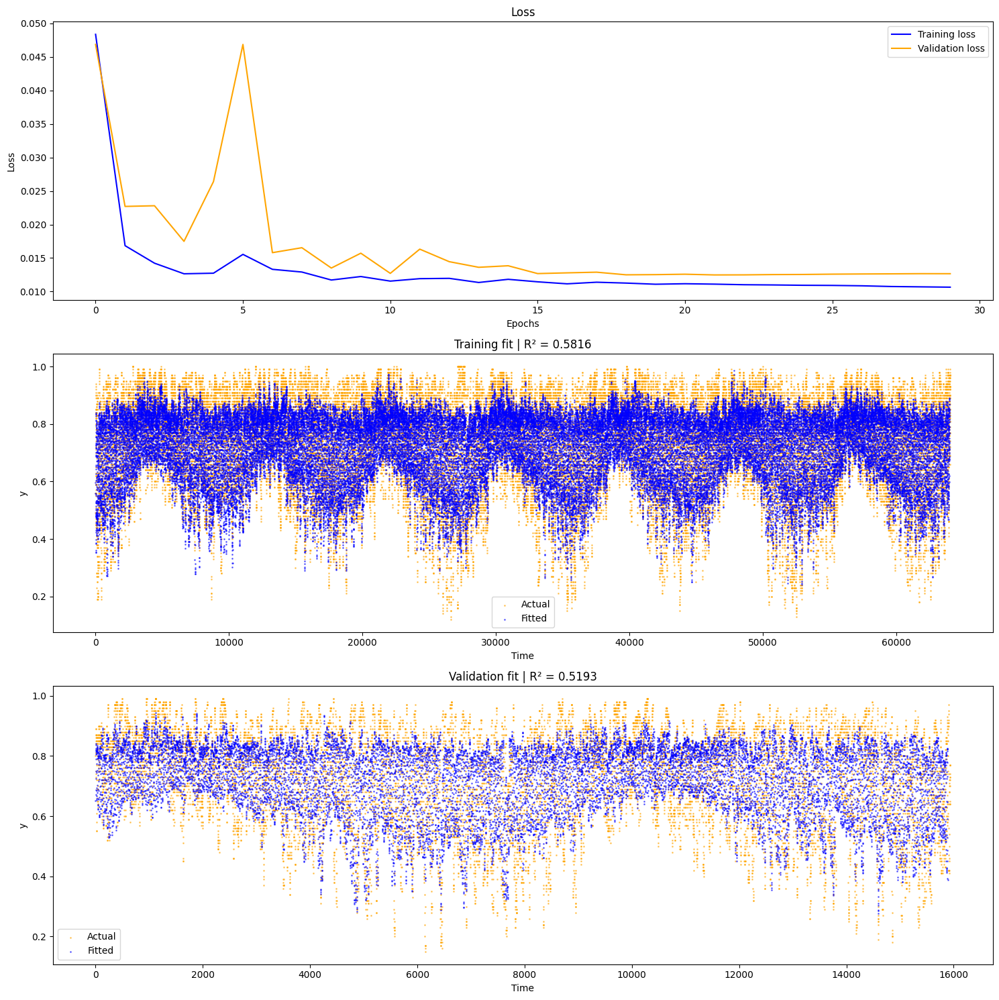

In [400]:
plot_lstm_results(new_lstm_mse_24h_128)

In [393]:
new_lstm_mae_24h = fit_lstm(new_df_train, 24, 48, 1, 64, 32, 30, 2, "mae")

Model: "Weather_forcaster"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer_69 (InputLayer)     │ (None, 48, 14)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_188 (LSTM)                 │ (None, 32)             │         6,016 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_69 (Dense)                │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 6,049 (23.63 KB)

 Trainable params: 6,049 (23.63 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/30
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 12s 11ms/step - loss: 0.1516 - val_loss: 0.1619
Epoch 2/30
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 10s 10ms/step - loss: 0.0966 - val_loss: 0.1034
Epoch 3/30
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 10s 10ms/step - loss: 0.0847 - val_loss: 0.0919
Epoch 4/30
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 10s 10ms/step - loss: 0.0833 - val_loss: 0.0864
Epoch 5/30
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 10s 10ms/step - loss: 0.0825 - val_loss: 0.0869
Epoch 6/30
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 10s 10ms/step - loss: 0.0819 - val_loss: 0.0891
Epoch 7/30
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 11s 11ms/step - loss: 0.0813 - val_loss: 0.0898
Epoch 8/30
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 11s 11ms/step - loss: 0.0809 - val_loss: 0.0922
Epoch 9/30
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 11s 11ms/step - loss: 0.0806 - val_loss: 0.0955
Epoch 10/30
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 11s 11ms/step - loss: 0.0802 - val_loss: 0.0997
Epoch 11/30
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 12s 12ms/step - loss: 0.0799 - val_loss: 0.1004
Epoch 12

1000/1000 ━━━━━━━━━━━━━━━━━━━━ 5s 5ms/step
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 5s 5ms/step
249/249 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
249/249 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step


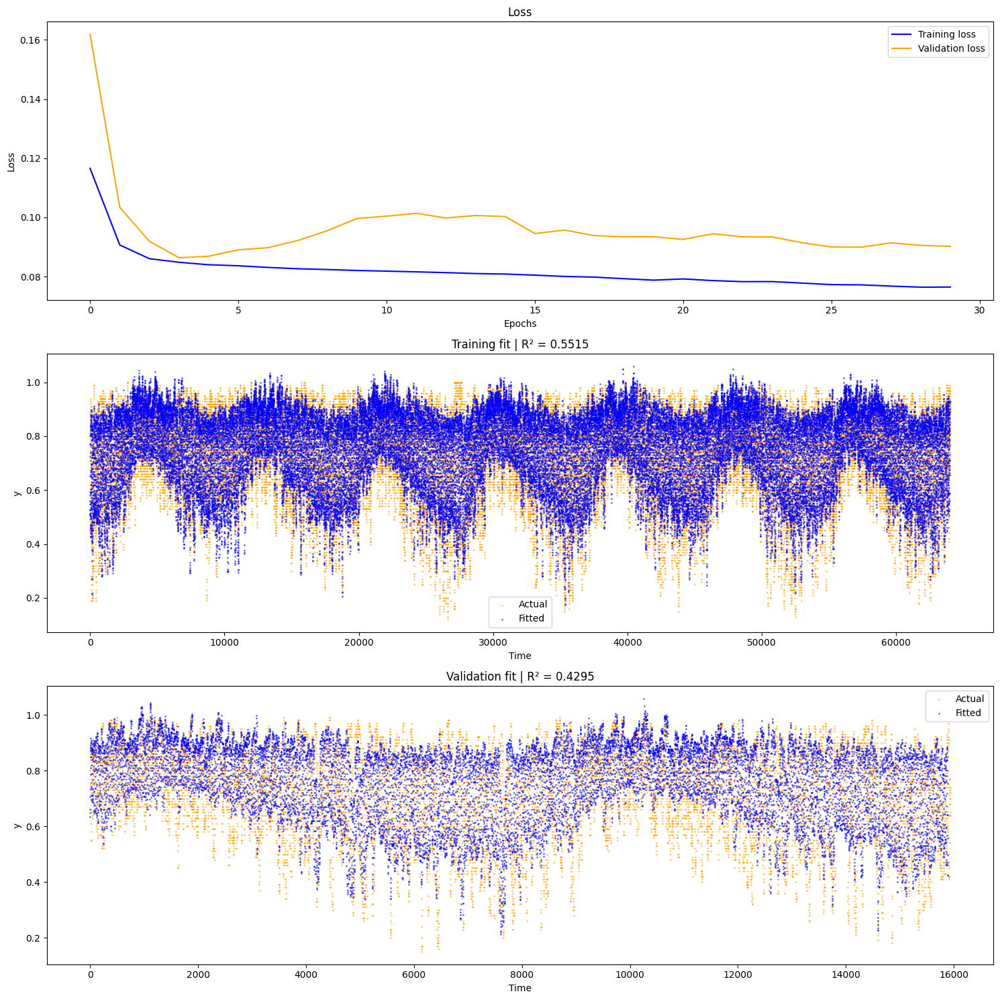

In [394]:
plot_lstm_results(new_lstm_mae_24h)

In [ ]:
new_lstm_mse_24h = fit_lstm(new_df_train, 24, 48, 1, 64, 32, 30, 2, "mse")

Model: "Weather_forcaster"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer_70 (InputLayer)     │ (None, 48, 14)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_190 (LSTM)                 │ (None, 32)             │         6,016 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_70 (Dense)                │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 6,049 (23.63 KB)

 Trainable params: 6,049 (23.63 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/30
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 12s 11ms/step - loss: 0.0538 - val_loss: 0.0426
Epoch 2/30
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 10s 10ms/step - loss: 0.0142 - val_loss: 0.0263
Epoch 3/30
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 10s 10ms/step - loss: 0.0122 - val_loss: 0.0220
Epoch 4/30
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 11s 11ms/step - loss: 0.0118 - val_loss: 0.0190
Epoch 5/30
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 11s 11ms/step - loss: 0.0116 - val_loss: 0.0165
Epoch 6/30
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 10s 10ms/step - loss: 0.0114 - val_loss: 0.0145
Epoch 7/30
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 11s 11ms/step - loss: 0.0112 - val_loss: 0.0133
Epoch 8/30
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 10s 10ms/step - loss: 0.0110 - val_loss: 0.0130
Epoch 9/30
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 12s 12ms/step - loss: 0.0109 - val_loss: 0.0133
Epoch 10/30
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 12s 12ms/step - loss: 0.0108 - val_loss: 0.0138
Epoch 11/30
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 11s 11ms/step - loss: 0.0108 - val_loss: 0.0142
Epoch 12

1000/1000 ━━━━━━━━━━━━━━━━━━━━ 7s 6ms/step
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 6s 6ms/step
249/249 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
249/249 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step


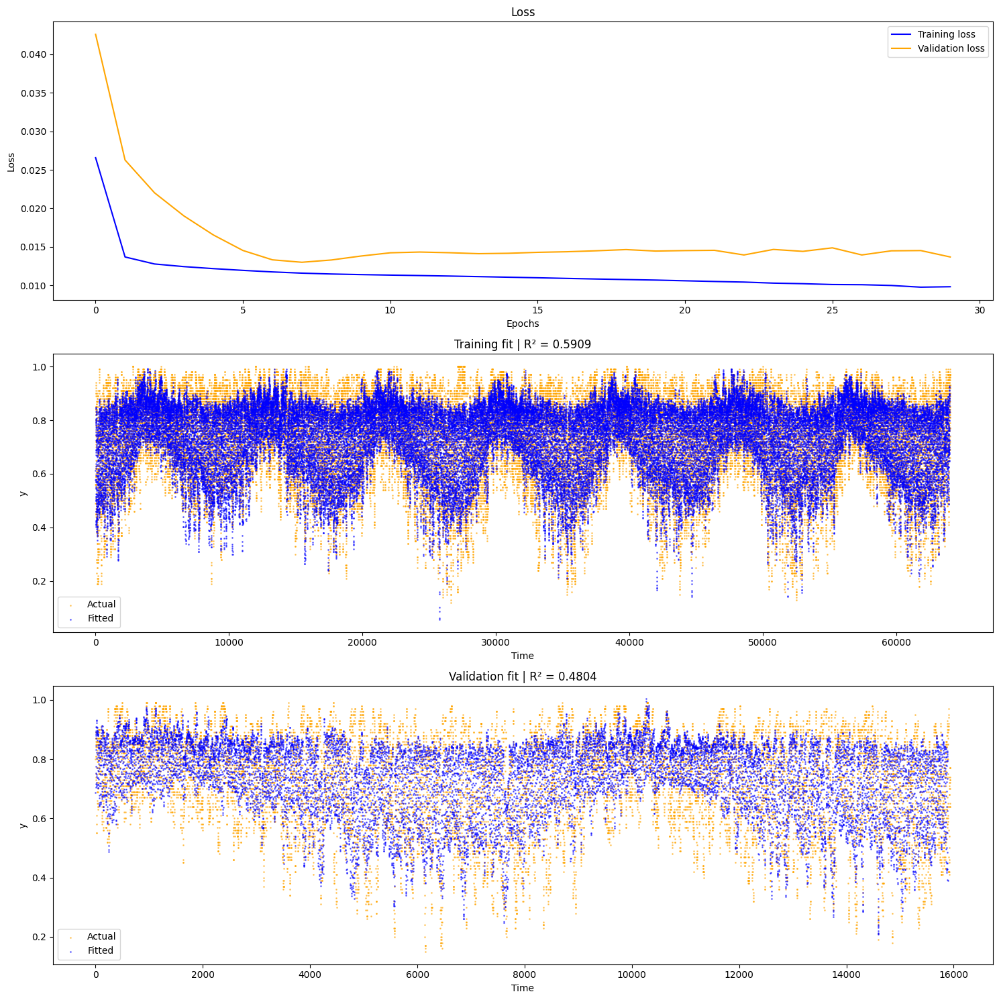

In [396]:
plot_lstm_results(new_lstm_mse_24h)

# Run models on test data

In [ ]:
rh_model = load_model("../models/rh_lstm.keras")
feats_model = load_model("../models/feats_lstm.keras")

## 1 hour - basic LSTM

In [ ]:
test_fit_1h = rh_model.predict(df_test.drop(columns=['date_time', 'relative_humidity']).values)

In [ ]:
test_fit_1h_mae = mean_squared_error(df_test[24:]['relative_humidity'].values, test_fit_1h)
test_fit_1h_mse = mean_squared_error(df_test[24:]['relative_humidity'].values, test_fit_1h)
test_fit_1h_r2 = r2_score(df_test[24:]['relative_humidity'].values, test_fit_1h)
print(f"MAE of RH predictions: {test_fit_1h_mae}")
print(f"MSE of RH predictions: {test_fit_1h_mse}")
print(f"R² of RH predictions: {test_fit_1h_r2}")

plt.figure(figsize=(15, 5))
plt.scatter(df_test[24:], df_test[24:]['relative_humidity'].values, label='Actual RH', color='orange', alpha = 0.5, s = 1)
plt.scatter(df_test[24:], test_fit_1h, label='Predicted RH', color='blue', alpha = 0.5, s = 1)
plt.title('Multi-step LSTM 6-hour Prediction (Validation) | R²: {:.4f}'.format(test_fit_1h_r2))

## 6 hours - Multi-step LSTM

In [ ]:
from tensorflow.keras.models import load_model

In [54]:
test_fit_6h = rolling_rh_forecast_on_validation_np(
    feats_model=feats_model,
    rh_model=rh_model,
    val_df=df_test,
    feats_list=feats_list,
    sequence_length=48,
    predict_steps=5
)

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
Predicted RH for index 15807: [[0.5475984]]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
Predicted RH for index 15808: [[0.539101]]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
Predicted RH for index 15809: [[0.53406143]]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
Predicted RH for index 15810: [[0.5193256]]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
Predicted RH for index 15811: [[0.5540323]]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 48ms/step
Predicted RH for index 15812: [[0.5892632]]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step
Predicted RH for index 15813: [[0.58651805]]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
Predicted RH for index 15814: [[0.6229305]]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1

MAE of RH predictions: 0.007302621143593836
MSE of RH predictions: 0.007302621143593836
R² of RH predictions: 0.7032426179347345


Text(0.5, 1.0, 'Multi-step LSTM 6-hour Prediction (Validation) | R²: 0.7032')

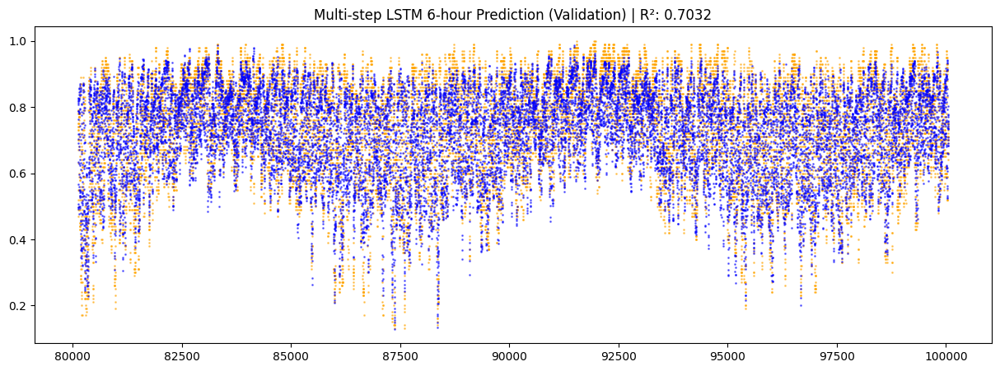

In [60]:
test_fit_6h_mae = mean_squared_error(df_test[77:]['relative_humidity'].values, test_fit_6h)
test_fit_6h_mse = mean_squared_error(df_test[77:]['relative_humidity'].values, test_fit_6h)
test_fit_6h_r2 = r2_score(df_test[77:]['relative_humidity'].values, test_fit_6h)
print(f"MAE of RH predictions: {test_fit_6h_mae}")
print(f"MSE of RH predictions: {test_fit_6h_mse}")
print(f"R² of RH predictions: {test_fit_6h_r2}")

plt.figure(figsize=(15, 5))
plt.scatter(df_test.index[77:], df_test[77:]['relative_humidity'].values, label='Actual RH', color='orange', alpha = 0.5, s = 1)
plt.scatter(df_test.index[77:], test_fit_6h, label='Predicted RH', color='blue', alpha = 0.5, s = 1)
plt.title('Multi-step LSTM 6-hour Prediction (Validation) | R²: {:.4f}'.format(test_fit_6h_r2))

## 24 hours - LSTM with added features

In [ ]:
new_df_test = add_fourier_time_features(df_test)
test_fit_24h = new_lstm_mse_24h[2].predict(new_df_test.drop(columns=['date_time', 'relative_humidity']).values)

In [ ]:
test_fit_24h_mae = mean_squared_error(new_df_test[24:]['relative_humidity'].values, test_fit_24h)
test_fit_24h_mse = mean_squared_error(new_df_test[24:]['relative_humidity'].values, test_fit_24h)
test_fit_24h_r2 = r2_score(new_df_test[24:]['relative_humidity'].values, test_fit_24h)
print(f"MAE of RH predictions: {test_fit_24h_mae}")
print(f"MSE of RH predictions: {test_fit_24h_mse}")
print(f"R² of RH predictions: {test_fit_24h_r2}")

plt.figure(figsize=(15, 5))
plt.scatter(new_df_test[24:], new_df_test[24:]['relative_humidity'].values, label='Actual RH', color='orange', alpha = 0.5, s = 1)
plt.scatter(new_df_test[24:], test_fit_24h, label='Predicted RH', color='blue', alpha = 0.5, s = 1)
plt.title('Multi-step LSTM 6-hour Prediction (Validation) | R²: {:.4f}'.format(test_fit_24h_r2))

# Save models

In [ ]:
best_model_mae[2].save('rh_lstm.keras')
# best_model_mae: (dataset_train, dataset_val, model, loss, val_loss, data_split)


In [419]:
feats_model.save('feats_lstm.keras')